In [1]:
import json
from ast import literal_eval
import pandas as pd
import networkx as nx
import unidecode
import nltk
# nltk.download('all')
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import numpy as np
import powerlaw
from nltk.text import Text
import cv2
from wordcloud import WordCloud, STOPWORDS
import networkx.algorithms.community as nx_comm
from community import community_louvain
from nltk.tokenize import WordPunctTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from collections import Counter
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import statistics
from PIL import Image
from collections import Counter
from fa2 import ForceAtlas2
from plotly.io import write_image
import plotly.io as pio
import plotly_express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import random
import re

In [61]:
def plot_fig(value, text, folder):
    fig = go.Figure(go.Indicator(
    mode = 'number',
    value = value,
    title = {'text': text}
    ))
    fig.write_json(f"plots/{folder}.json")
    fig.show()

# 1. Motivation

For this project, we chose to analyse the American TV series **The Office**, the most-watched series across streaming in 2020, with 57.1 billion minutes streamed. This includes detailed season and rating statistics, character statistics, relationships and their influence on the success of the show measured in terms of IMDb ratings and views. We present our analysis through interactive visualizations we created using Plotly. 

As viewers of The Office, we would like to get deeper insights on the success behind The Office, an American mockumentary sitcom television series based in Scranton, Pennsylvania that narrates the work of employees in the Dunder Mifflin paper company.
Besides, we would like to use the knowledge learned in the Social Graphs course to back up the assumptions and ideas we created while watching the TV series, such as the famous ***That's what she said***,  Andy's ***Big Tuna***, Angela's affection to her cats, Kelly's love for Ryan or Dwight's eagerness to become Regional Manager of Scranton. 

We would like to verify whether other people relate to our feelings after Michael left or affection to the main characters protagonism in the series, such as when Andy Bernard was Regional Manager.

Let’s get started!
<img src="imgs/all_jump.gif" width="750" height="750"/>

### 1.1. What datasets did we use?  1.2. Why did we choose these datasets?

We used four datasets:

#### Dunderpedia: The Office Wiki
Encyclopedia dedicated to housing an informative database for all subject matter related to The Office

- Using [**Dunderpedia: The Office Wiki**](https://theoffice.fandom.com/) we first extracted all the characters that played in The Office from season 1 to season 9 (final). Besides, we downloaded the description of each character.     
##### What did we use this dataset for?
This data was used to create a network between all of the characters of The Office based on their descriptions.  To achieve this goal we have used regular expressions! From the network, we identified communities. Moreover, we used the character descriptions to create word-clouds for 16 of the main characters. 

#### IMDb 
IMDb Ratings of The Office

- Using [**IMDb**](https://www.imdb.com/title/tt0386676) we made AJAX requests and using BeautifulSoup we extracted information about every episode of every season of The Office. This includes episode titles for all seasons, IMDb ratings, total votes, description and air date of every episode. 
##### What did we use this dataset for?
This data was used for exploratory data analysis of the popularity and success of The Office throughout the seasons. More specifically, on its own, this dataset was used to study the variation of votes, views and ratings during the 9 seasons and perform analysis for what went wrong in seasons 8 and 9 after Michael (the main character) left. Then it was combined with the Transcripts dataset to analyse the impact of every character on the success of the show.

#### Kaggle: The Office Dataset
Dataset of all episodes of the popular US TV Series - The Office

 - From [**Kaggle**](https://www.kaggle.com/nehaprabhavalkar/the-office-dataset), we downloaded The Office dataset to extend the previously downloaded IMDb data. The new data includes guest stars, directors and writers. 
 
  It is important to note that even though this Office dataset from Kaggle also contains the ratings and Viewership of the Office, it has not been updated since `September 2020`. Therefore, we wanted to extract these data directly from IMDb to have the most up-to-date ratings and views. Since The Office is still available on Network and has been watched 50.1 billion times in 2020, these ratings are likely to be changing frequently. Hence, from this Kaggle dataset, we only took the static data: guest stars, writers and directors. 

 ##### What did we use this dataset for?
 This data was used to analyse the impact of guest stars, directors and writers on the ratings and views. We analysed the most talented writers and directors and the ratings when episodes were directed or written by members of the cast. Then we looked into the best director-writer combinations with respect to ratings.
 
 
####  Kaggle: The Office (US) - Complete Dialogue/Transcript
45,000+ lines of dialogue from 9 seasons of The Office

 - To further analyse the episode ratings, we needed information about the episode itself, such as the cast for each episode and the lines for each character in every episode. This is collected from the [**Kaggle dataset: The Office (US) - Complete Dialogue/Transcript**](https://www.kaggle.com/nasirkhalid24/the-office-us-complete-dialoguetranscript/version/1?select=The-Office-Lines.csv).
##### What did we use this dataset for?
This data was used to analyse the impact of every character in The Office ratings and views based on the number of lines said and the episodes where each character was present. Due to the low ratings of seasons 8 and 9, we extended our analysis to look for a relation between the top speaker of every season and the ratings. We also created word-clouds for the 16 main characters based on their transcripts and compared them to the word-clouds we created with the Dunderpedia description. 
We also performed sentiment analysis using the LabMT and Vader methods to determine the happiest and saddest characters. Finally, we looked into the main character's relationships based on the lines exchanged between them, and we created a network based on their relations. 

<img src="imgs/michael_explain.gif" width="950" height="750"/>

### 1.3. What is our goal for the end user's experience?

Our goal is to be able to show the analysis conducted on The Office TV series through aesthetically pleasing and interactive plots visualizations that users can interact with.

For this, we created visualizations using [Plotly Python library](https://github.com/plotly/plotly.py). An open-source python library built on top of *d3.js* that allows for interactive visualizations not only in our Jupyter notebook but also in our website thanks to Plotly's support for web-based visualizations. 

We combined the nice visualizations with the knowledge and techniques we mastered during the Social Graphs course. This includes pre-processing the data using regex expression, using `pandas` for easier analysis and manipulation of the chosen datasets, using `NetworkX` for network generation and visualization, performing sentiment analysis using the Vader and LabMT method and creating word-clouds.

When the user finishes reading this notebook, he/she should have a deeper understanding of the statistics behind The Office, the characters' influence in The Office success, fun facts, and most importantly, an idea of who each character is, what their personalities are about and their relationships. 

Moreover, a reader familiar with the series will also back up his/her opinions and point of view with statistical evidence.


# 2. Basic stats. 
###  Let's understand The Office datasets better. 

* [Data Collection and Preprocessing](#data_collection)
    * [Data collection and Pre-processing: Dunderpedia: The Office Wiki](#data_collection_dunderpedia)
    * [Data collection and Pre-processing: IMDb and Kaggle: The Office Dataset](#data_collection_imdb)
    * [Data collection and Pre-processing: Kaggle:  The Office (US) - Complete Dialogue/Transcript](#data_collection_transcripts)
    

## 2.1. Data Collection and Preprocessing  <a class="anchor" id="data_collection"></a>

In this section, we will explain how we collected and preprocessed the data from the 4 sources we previously identified.

### 2.1.1. Data collection and Pre-processing: Dunderpedia: The Office Wiki <a class="anchor" id="data_collection_dunderpedia"></a>

We used the Dunderpedia API to collect the character names and their descriptions. Then we preprocessed these descriptions to find links between characters, their workplaces and their departments. 

Since this process is long and time-consuming, we have extracted it in a different notebook. Please refer to this [Notebook: Preprocessing_Dunderpedia](Preprocessing_Dunderpedia.ipynb) for the code and explanations on how the data was collected and pre-processed using regex. The regex descriptions and explanations can be found here:

* [Regular expression: Find character categories](Data%20collection%20and%20Preprocessing%20Dunderpedia.ipynb#regex_categories)
*  [Regular expression: Find character work position](Data%20collection%20and%20Preprocessing%20Dunderpedia.ipynb#regex_position)
* [Regular expression: Extract character links](Data%20collection%20and%20Preprocessing%20Dunderpedia.ipynb#regex_links)

See: *Preprocessing_Dunderpedia.ipynb*


The result of the data collection and preprocessing was saved to a CSV file: `data/dunderpedia_characters.csv`. Besides, for each character, we saved their respective page contents in a text file and place them in the folder: `data/characters/`.

For simplicity, a pandas dataframe is created from the CSV file `data/dunderpedia_characters.csv`:

In [3]:
# read previously saved data from Dunderpedia
# treat the Links column as a lisk - when saving to csv and reading again it is treat as string otherwise
dunderpedia_df = pd.read_csv('data/dunderpedia_characters.csv',
                            converters={"Links": literal_eval}) 

dunderpedia_df.head()

,Name,Main Role,Secondary Roles,Position,Branch,Links,ImagePath
0,A.J.,NaN,['Males'],['A salesman and ex-boyfriend of [[Holly Flax|...,['Dunder Mifflin Nashua'],"[Holly Flax, Holly Flax, Michael Scott, Pam Be...",A.J..jpg
1,Abby,NaN,"['Females', 'Family members']",[],[],"[Stacy, Pam Beesly]",Abby.png
2,Alan,NaN,[],[],[],"[Kelly Kapoor, Ryan Howard, Pam Beesly]",Alan.jpg
3,Alan Brand,NaN,"['Dunder Mifflin employees', 'Former employees...",['CEO '],['Dunder Mifflin Corporate Office'],"[Jan Levinson, Michael Scott, Oscar Martinez, ...",Alan_Brand.png
4,Alex,NaN,['Males'],[],[],"[Pam Beesly, Alex, Karen Filippelli]",Alex.jpg


### 2.1.2. Data collection and Pre-processing: IMDb and Kaggle: The Office Dataset  <a class="anchor" id="data_collection_imdb"></a>

We queried the [IMDb](https://www.imdb.com) website using AJAX requests and extract the information for The Office. IMDb doesn't have an official API, so we had to find the ID of The Office in IMDb: `tt0386676` in order to proceed and make queries.

The data from IMDb has been merged with the notebook from Kaggle: *The Office Dataset*. For this we used the `KaggleApi` from `kaggle` python library. 

Once again, we have extracted this process in a separate notebook for consistency. Please refer to this [Notebook: Preprocessing_IMDB_Kaggle_Office](Preprocessing_IMDB_Kaggle_Office.ipynb)

See: *Preprocessing_IMDB_Kaggle_Office.ipynb*

The result of the data collection and preprocessing of the Kaggle and IMDb data was saved to a CSV file: `data/imdb_ratings.csv`.

For simplicity, a pandas dataframe is created from the CSV file `data/imdb_ratings.csv`:

In [4]:
# read previously saved data from IMDb and Kaggle:The Office Dataset
# the writers column is a list - we need to specify that so it is not treated as a string
imdb_df = pd.read_csv('data/imdb_ratings.csv', 
                      converters={"Writers": literal_eval}) 
imdb_df.head()

,Season,Episode,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description,Viewership,GuestStars,Director,Writers,Number of Guest Stars
0,1,1,Pilot,7.4,7134,24 Mar 2005,The premiere episode introduces the boss and s...,11.2,NaN,Ken Kwapis,"[Ricky Gervais , Stephen Merchant and Greg Dan...",0
1,1,2,Diversity Day,8.3,7033,16 Mar 2005,Michael's off color remark puts a sensitivity ...,6.0,NaN,Ken Kwapis,[B. J. Novak],0
2,1,3,Health Care,7.7,5863,5 Apr 2005,Michael leaves Dwight in charge of picking the...,5.8,NaN,Ken Whittingham,[Paul Lieberstein],0
3,1,4,The Alliance,8.0,5673,12 Apr 2005,"Just for a laugh, Jim agrees to an alliance wi...",5.4,NaN,Bryan Gordon,[Michael Schur],0
4,1,5,Basketball,8.4,6299,19 Apr 2005,Michael and his staff challenge the warehouse ...,5.0,NaN,Greg Daniels,[Greg Daniels],0


### 2.1.3. Data collection and Pre-processing: Kaggle:  The Office (US) - Complete Dialogue/Transcript <a class="anchor" id="data_collection_transcripts"></a>

From Kaggle: *The Office (US) - Complete Dialogue/Transcript*, we used the `KaggleApi` from `kaggle` python library and extracted the data. 

Once again, we have extracted this process in a separate notebook. Please refer to this [Notebook: Preprocessing_KaggleTranscripts](Preprocessing_KaggleTranscripts.ipynb) for a detailed explanation and code on how the Transcript dataset was created.

See: *Preprocessing_KaggleTranscripts.ipynb*

The result of the data collection and preprocessing of the Kaggle was saved to a CSV file: `data/transcripts.csv`.

For simplicity, a pandas dataframe is created from the CSV file `data/transcripts.csv`:

In [5]:
# read previously saved data from IMDb and Kaggle:The Office Dataset
transcripts_df = pd.read_csv('data/transcripts.csv') 
transcripts_df.head()

,season,episode,title,scene,speaker,line
0,1,1,Pilot,1,Michael,All right Jim. Your quarterlies look very good...
1,1,1,Pilot,1,Jim,"Oh, I told you. I couldn't close it. So..."
2,1,1,Pilot,1,Michael,So you've come to the master for guidance? Is ...
3,1,1,Pilot,1,Jim,"Actually, you called me in here, but yeah."
4,1,1,Pilot,1,Michael,"All right. Well, let me show you how it's done."


#### Main characters transcript analysis

For the rest of the analysis, we will work with the transcripts for the main characters, so let's extract them:

We use the `dunderpedia_df` to select the characters whose role is `Main Characters`. These are the main characters according to the Dunderpedia Wiki.

In [6]:
# get the names of the main characters from the dunderpedia_df whose Main Role is Main Characteres
main_characters = dunderpedia_df.loc[dunderpedia_df['Main Role'] == 'Main Characters']['Name']

main_character_names = list(map(lambda full_name: full_name.split(' ')[0], list(main_characters)))

print(f'The lead characters in The Office are: {main_character_names}')

The lead characters in The Office are: ['Andy', 'Angela', 'Clark', 'Creed', 'Darryl', 'Dwight', 'Erin', 'Gabe', 'Jan', 'Jim', 'Karen', 'Kelly', 'Kevin', 'Meredith', 'Michael', 'Nellie', 'Oscar', 'Pam', 'Pete', 'Phyllis', 'Robert', 'Roy', 'Ryan', 'Stanley', 'Toby']


Now that we have the names of the 25 main characters, we will create a new dataframe `main_character_transcripts_df` that contains the transcripts from the speakers in the `main_character_names` list:

In [7]:
main_character_transcripts_df = transcripts_df.query('speaker in @main_character_names') # extract transcripts

main_character_transcripts_df.head()

,season,episode,title,scene,speaker,line
0,1,1,Pilot,1,Michael,All right Jim. Your quarterlies look very good...
1,1,1,Pilot,1,Jim,"Oh, I told you. I couldn't close it. So..."
2,1,1,Pilot,1,Michael,So you've come to the master for guidance? Is ...
3,1,1,Pilot,1,Jim,"Actually, you called me in here, but yeah."
4,1,1,Pilot,1,Michael,"All right. Well, let me show you how it's done."


### 2.2. Basic Stats: Understanding the datasets <a class="anchor" id="basic_stats"></a>

In this section, we will further understand the data from the 4 datasets (and 3 dataframes) that we have collected and preprocessed. This also includes the creation of a network from Dunderpedia. 

* [Basic Stats: Understanding the datasets](#basic_stats)
    * [Basic Stats: Dunderpedia: The Office Wiki](#stats_dunderpedia)
    * [Basic Stats: IMDb](#stats_imdb)
    * [Basic Stats: Kaggle:  The Office (US) - Complete Dialogue/Transcript](#stats_transcripts)

### Basic Stats: Dunderpedia: The Office Wiki <a class="anchor" id="stats_dunderpedia"></a>

We start our Dunderpedia analysis by generating The Office network, which includes all the characters in the Office extracted from the Dunderpedia. 

The nodes in the network will be all the characters, and we will place an edge between nodes **A** and **B** if the Dunderpedia wiki page of node **A** links to the Dunderpedia Wiki page of node **B**. 

For every character, we have found their main and secondary roles, their thumbnails and their names. This information will be used to identify each node in the network by including an `attribute` for each characteristic. 

We use `NetworkX DiGraph` to store the network and we store also the properties of the nodes (i.e. Main Role, Sub role and Image Path).

In [9]:
G = nx.DiGraph()

# iterate through all the rows in pandas df and add nodes
for index, row in dunderpedia_df.iterrows():
    name = row['Name']
    img = row['ImagePath']
    main_role = row['Main Role']
    sub_roles = row['Secondary Roles']
    
    # add node 
    G.add_node(name, img=img, main_role=main_role, sub_roles=sub_roles)
    links = row['Links']
    for link in links:
        if link != name and link in list(dunderpedia_df.Name): # do not include links that point to the same character
            G.add_edge(name, link)

We now check for isolated nodes, and we remove them:

In [12]:
print(f"The network contains {len(list(nx.isolates(G)))} isolated nodes.")

The network contains 17 isolated nodes.


In [13]:
G.remove_nodes_from(list(nx.isolates(G))) # remove isolated nodes in graph
print(f"Number of isolated nodes in graph after removal: {len(list(nx.isolates(G)))}")

Number of isolated nodes in graph after removal: 0


For futher analysis, we will work with the undirected version of Giant Connected Component of our network.

We extract the GCC and then we convert it into an undirected graph.

In [14]:
gcc = max(nx.weakly_connected_components(G), key=len) # find the maximum connected component in G
G = G.subgraph(gcc) # the gcc we will operate with
G_undirected = G.to_undirected() # convert gcc to undirected graph

Next, we would like to get some insights into our network. For this, we perform simple network statistics and analysis. We use the GCC to report the results.

* **What is the number of nodes in the network?**


In [62]:
plot_fig(len(G.nodes()), 
         'The number of nodes in The Office network is', 'dunderpedia_network/04-nodes')

* **What is the number of links?**

In [63]:
plot_fig(len(G.edges()), 
         'The number of links in The Office network is', 'dunderpedia_network/05-links')

* **Who is the top connected character in The Office?**

We report out results for the in-degrees and out-degrees.

To calculate the in-degrees and out-degrees we use the `in_degree()` and `out_degree()` functions, respectively. These functions return a collection of tuples representing every node in the network and their respective degree. 

In [95]:
# create a list of tuples containing the node (n) and its degree (d) - for the in and out degrees
in_degrees = [(n,d) for n,d in G.in_degree()] 
out_degrees = [(n,d) for n,d in G.out_degree()]

# sort the in- and out-degrees from high to low by degree (second element in the tuple - at index 1)
in_degrees.sort(reverse=True, key=lambda x: x[1])
out_degrees.sort(reverse=True, key=lambda x: x[1])

plot_fig(in_degrees[0][1], 
         f"The top connected character in The Office for the in-degrees is:" +\
         f" <b>{in_degrees[0][0]}</b>, with a degree of", 'dunderpedia_network/06-top_in_degrees')

The top connected character in The Office for the in-degrees is **Michael Scott**, with a 108 in-degree. Michael is the main character of The Office, and Regional Manager of the Scranton branch from season 1 to 7. Hence it makes sense that a lot of characters point to him as he is the main character and has relations to most of the other chraracters. 

In [96]:
plot_fig(out_degrees[0][1], 
         f"The top connected character in The Office for the out-degrees is:"+\
         f" <b>{out_degrees[0][0]}</b>, with a degree of", 'dunderpedia_network/07-top_out_degrees')

The top connected character in The Office for the out-degrees is **Andy Bernard**, with a 33 out-degree. In the series, Andy Bernard tries to please everyone, so it makes sense that he is the one pointing to the most characters.

* **Who are the top 5 most connected characters (in terms of in- and out-degree)?**

Using the previously sorted `in_degrees` and `out_degrees` we will selected the top 5 nodes from each list.

In [22]:
in_connectivity = list(map(lambda x: x/len(G.nodes()), list(zip(*in_degrees))[1]))
out_connectivity = list(map(lambda x: x/len(G.nodes()), list(zip(*out_degrees))[1]))

zipped_in_degrees = list(zip(*in_degrees[:5]))
characters_in_degree = zipped_in_degrees[0]
in_degree_vals = zipped_in_degrees[1]

zipped_out_degrees = list(zip(*out_degrees[:5]))
characters_out_degree = zipped_out_degrees[0]
out_degree_vals = zipped_out_degrees[1]

In [23]:
fig = make_subplots(rows=2, cols=1, vertical_spacing=0.1, shared_xaxes=False, 
                    x_title='character',
                    y_title='degree',
                    subplot_titles=("The top 5 connected character in The Office for the in-degrees",
                                    "The top 5 connected character in The Office for the out-degrees"))

fig.add_trace(go.Scatter(x=characters_in_degree, 
                y=in_degree_vals,
                name='in-degree',
                line=dict(color='red', width=2.5),
                text=['<br>'f"<b>{v:.2f}%</b> of the nodes have incoming edges to it" for v in in_connectivity],
                hovertemplate = "<b>%{x}</b> has an in-degree of <b>%{y}</b> %{text}", 
                textposition="bottom center"),
              row=1, col=1)
    
fig.add_trace(go.Scatter(x=characters_out_degree, 
            y=out_degree_vals,
            name='out-degree',
            line=dict(color='green', width=2.5),
            text=['<br>'f"It has outgoing edges to <b>{v:.2f}%</b> of the nodes" for v in out_connectivity],
            hovertemplate = "<b>%{x}</b> has an in-degree of <b>%{y}</b> %{text}", 
            textposition="bottom center"),
          row=2, col=1)
    
fig.update_traces(hoverinfo='text', mode='lines+markers')
fig.update_layout(hovermode="x unified", height=1000)

fig.show()
fig.write_json("plots/dunderpedia_network/01-top_in_out_degree.json")

* **Plot the in- and out-degree distributions.**

To plot the binned in and out degree distributions, we compute the binning vector of both degrees.
To compute the binning vector, we create a list of values spaced by 1 step, where the goal is to have as many bins as unique values in our data such that when the histogram is computed, they range from `min_value` to `max_value`. Hence, when creating the binning-vector, the first element has to be half-step less than the minimum value and the last element half-step more than the maximum value plus one becausethere is one more edge than bins. 

In [24]:
def get_degree_distribution(degrees):
    """
    Organize the degrees in bins so as to plot the binned degree distribution
    """
    max_degree = max(degrees)
    min_degree = min(degrees)

    v = np.arange(min_degree-0.5, max_degree+1.5)
    bins_count, bins = np.histogram(degrees, v)

    # find the middle value between bins and create a new list of bins.
    bins_new = []
    for index, value in enumerate(bins[0:-1]):
        avg = np.mean((value, bins[index+1]))
        bins_new.append(avg)
    
    return bins_new, bins_count

In [25]:
in_degrees = [d for n,d in G.in_degree()] # from the tuple node, degree, get only the degrees
out_degrees = [d for n,d in G.out_degree()]

# compute the degree distribution in bins for the in- and out-degrees
in_bins, in_bins_count = get_degree_distribution(in_degrees)
out_bins, out_bins_count= get_degree_distribution(out_degrees)

Now we plot their distributions and bar and scatter plots:

In [26]:
fig = make_subplots(rows=2, cols=2, vertical_spacing = 0.07,
                    x_title='count',
                    y_title='degree',
                    subplot_titles=("Binned in-degree distribution bar plot",
                                    "Binned in-degree distribution scatter plot", 
                                    "Binned out-degree distribution bar plot",
                                    "Binned out-degree distribution scatter plot"))

fig.add_trace(
    go.Bar(x=in_bins, y=in_bins_count),
    row=1, col=1)

fig.add_trace(
    go.Scatter(x=in_bins, y=in_bins_count),
    row=1, col=2)

fig.add_trace(
    go.Bar(x=out_bins, y=out_bins_count),
    row=2, col=1)

fig.add_trace(
    go.Scatter(x=out_bins, y=out_bins_count),
    row=2, col=2)

fig.update_layout(height=900, width=950, showlegend=False, title_text="In- and out- degree distributions of the Dunderpedia network")
fig.show()
fig.write_json("plots/dunderpedia_network/02-degree_distributions.json")

The first thing that we can observe is that maximum out-degree is more than 3 times smaller than maximum in-degree, which could have also be seen in the previous question, when we examined the top nodes based on in- and out-degree, Michael and Andy. 

In the in-degree plots it can be seen that there majority of nodes, nearly 100, have a degree of 0, and the degree ranges until 108. Hence, the distribution shows that a large number of characters point to a small number of characters. While in the out-degree plots, the degree distribution changes slower than the in-degree, and the degrees are more concentrated between 0 and 10, in comparison to the in-degre.

* **Why the in-degree distribution is different from the out-degree distribution?**

Because of the nature of the network. In this network, the link is defined between two characters, $A$ and $B$, if there exists a hyperlink in character's $A$ page that link to $B$'s page. Popular characters will therefore be linked by a lot of other characters, which can accounts for highers in-degrees. Therefore, for less popular characters, will have links pointing to other characters, but very little links pointing to them, which can cause the large amout in-degrees close to 0.

The out-degree might be limited by the page length and the fact that every characters includes a low number of hyperlinks in its page.

* **Find the exponent of the degree distribution (by using the `powerlaw` package) for the in- and out-degree distribution. What does it say about our network?**

In [27]:
in_exponent, out_exponent = powerlaw.Fit(in_degrees).alpha, powerlaw.Fit(out_degrees).alpha
print(f"The exponent of the in-degree distribution is {in_exponent:.4f}.")
print(f"The exponent of the out-degree distribution is {out_exponent:.4f}.")

Calculating best minimal value for power law fit
Calculating best minimal value for power law fit
The exponent of the in-degree distribution is 1.9976.
The exponent of the out-degree distribution is 2.6148.


Values less than or equal to 0 in data. Throwing out 0 or negative values
Values less than or equal to 0 in data. Throwing out 0 or negative values


* **Compare the degree distribution of the undirected graph to a *random network* with the same number of nodes and probability of connection *p*. Comment your results.**

To compare the degree distribution of our previously created undirected graph to a random network with the same number of nodes and probability of connection, we first create a random graph using the networkx `gnm_random_graph` function with the same number of edges and edges as our undirected graph. Then we use our `get_degree_distribution` function to get the degree distribution of both the undirected and the random graphs.

In [28]:
total_gu_nodes = len(G_undirected.nodes()) # compute the number of nodes in the undirected graph
total_gu_links = len(G_undirected.edges()) # compute the number of edges/links in the undirected graph

# Generate a random graph with the same number of nodes and edges (same probability of connection)
random_G = nx.gnm_random_graph(n=total_gu_nodes, m=total_gu_links)

random_g_bins, random_g_bins_count = get_degree_distribution(list(dict(random_G.degree()).values()))
gu_bins, gu_bins_count = get_degree_distribution(list(dict(G_undirected.degree()).values()))

In [29]:
fig = make_subplots(rows=2, cols=1, vertical_spacing=0.1, 
                    x_title='count',
                    y_title='degree',
                    subplot_titles=("Binned degree distribution of a Random network with " +\
                                    f"{total_gu_nodes} nodes and {total_gu_links} edges",
                                    "Binned degree distribution of the Dunderpedia Undirected graph with " +\
                                    f"{total_gu_nodes} nodes and {total_gu_links} edges")
                   )


fig.add_trace(
    go.Bar(x=random_g_bins, y=random_g_bins_count),
    row=1, col=1)

fig.add_trace(
    go.Bar(x=gu_bins, y=gu_bins_count),
    row=2, col=1)


fig.update_layout(height=800, width=900, showlegend=False, title_text="In- and out- degree distribitions of the Dunderpedia network")
fig.show()
fig.write_json("plots/dunderpedia_network/03-degree_distributions_random_network.json")

From the above plot it can be see that the degree distribution of the random network is similar to a normal distribution, with the higher degrees in the middle values (from 5 to 9), with the mean in 7, the mean value of the degree. On the other hand, the Undirected graph there is only one high peak on the degree 0, and the degree count starts to decrease after. 

**Next we create a nice visualization of the total (undirected) network:** 
We use the following formatting:
>   * Set the nodes icon to be the characters thumbnail
>   * Get node positions based on the spring_layout;

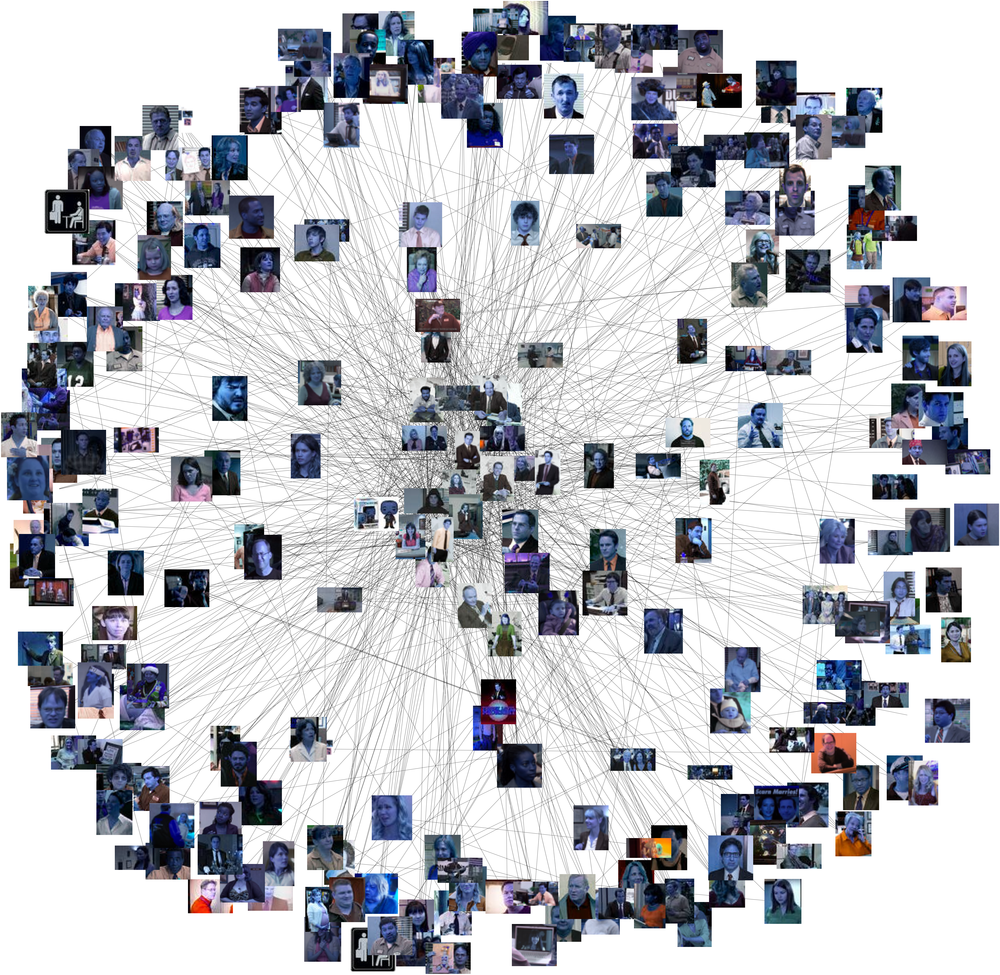

In [30]:
pos = nx.spring_layout(G_undirected, k = 0.5, iterations=20, scale=1.7) 
fig = plt.figure( figsize = (100, 100))
ax = plt.subplot(111)
ax.set_aspect('equal')
nx.draw_networkx_edges(G_undirected, pos, ax=ax)

plt.xlim(-1.5, 1.5)
plt.ylim(-1.5, 1.5)

trans = ax.transData.transform
trans2 = fig.transFigure.inverted().transform

piesize = 0.04  # this is the image size
p2 = piesize / 2.0
for n in G_undirected.nodes:
    xx , yy = trans(pos[n]) # figure coordinates
    xa , ya = trans2((xx , yy)) # axes coordinates
    a  =  plt.axes([xa - p2 , ya - p2 , piesize, piesize])
    a.set_aspect('equal')
    try :
        img = cv2.imread("./data/thumbnails/" + G_undirected.nodes[n]['img'])
        a.imshow(img)    
    except Exception :
        print(n)
        continue
    a.axis ('off')
ax.axis ('off')
plt.savefig ("plots/network.png")

The Dunderpedia Wiki was used as the only source for creating the network between characters. This network is later used, together with the character's descriptions, to identify communities between characters. 

To maintain a logical flow of ideas, the remaining statistics from the IMDb and Transcripts data is included in section 3 of this report since all the conducted statistics were used to understand the dataset and perform data analysis. 

However, in this section, we chose to include some basic statistics about the datasets sizes and structures, for this, we used the `pandas` library.

### Basic Stats: IMDb <a class="anchor" id="stats_imdb"></a>

In [31]:
imdb_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 188 entries, 0 to 187
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Season                 188 non-null    int64  
 1   Episode                188 non-null    int64  
 2   EpisodeTitle           188 non-null    object 
 3   IMDBRating             188 non-null    float64
 4   TotalVotes             188 non-null    int64  
 5   AirDate                188 non-null    object 
 6   Description            188 non-null    object 
 7   Viewership             188 non-null    float64
 8   GuestStars             29 non-null     object 
 9   Director               188 non-null    object 
 10  Writers                188 non-null    object 
 11  Number of Guest Stars  188 non-null    int64  
dtypes: float64(2), int64(4), object(6)
memory usage: 17.8+ KB


The IMDb dataset consists of **188** entries and 12 columns, resulting in a total of 17.8 KB of data.

In [32]:
imdb_df.describe()

,Season,Episode,IMDBRating,TotalVotes,Viewership,Number of Guest Stars
count,188.000000,188.000000,188.000000,188.000000,188.000000,188.000000
mean,5.468085,11.877660,8.216489,4190.622340,7.246330,0.202128
std,2.386245,7.024855,0.615655,1566.205866,2.066012,0.577285
min,1.000000,1.000000,6.400000,2770.000000,3.250000,0.000000
25%,3.000000,6.000000,7.800000,3232.500000,5.990000,0.000000
50%,6.000000,11.500000,8.200000,3811.500000,7.535000,0.000000
75%,7.250000,18.000000,8.600000,4603.250000,8.425000,0.000000
max,9.000000,26.000000,9.800000,15495.000000,22.910000,4.000000


Using the `pandas` describe function, we can see the following statistics for the IMDb data: 

- There are a total of 188 episodes, divided in 9 seasons. 
- Every season has an average of 12 episodes. 
- The average IMDb rating of an episode is **8.2**, with an average of **4191** votes. 
- On average, every episode is watched an **7.25** million times. 
- There is one guest star for every 5 episodes. 

- The most watched episode has been watched over **22.91** million times.
- The most popular episode has been rated with a score of **9.8/10**. 
- The worst performing episode has been rated with a score of **6.4/10**.
- The longest season has a total of 26 episodes. 

- The viewership ranges from **3.25**million to **22.91** million. 
- The ratings range from **6.4** to **9.8**.

Why is there such a big difference in the ratings and views? We will try to answer this question in section 3. 

### Basic Stats: The Office (US) - Complete Dialogue/Transcript <a class="anchor" id="stats_transcripts"></a>

In [33]:
transcripts_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54815 entries, 0 to 54814
Data columns (total 6 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   season   54815 non-null  int64 
 1   episode  54815 non-null  int64 
 2   title    54815 non-null  object
 3   scene    54815 non-null  int64 
 4   speaker  54813 non-null  object
 5   line     54815 non-null  object
dtypes: int64(3), object(3)
memory usage: 2.5+ MB


The Transcripts dataset consists of **54815** entries and 6 columns, resulting in a total of 2.9MB of data.

In [333]:
transcripts_df.describe()

,season,episode,scene
count,54815.000000,54815.000000,54815.000000
mean,5.540472,12.544158,4194.204232
std,2.340719,7.290869,2287.219112
min,1.000000,1.000000,1.000000
25%,4.000000,6.000000,2344.000000
50%,6.000000,12.000000,4236.000000
75%,8.000000,19.000000,6140.000000
max,9.000000,28.000000,8157.000000


Using the `pandas` describe function, we can see the following statistics for the Transcripts data: 

- There are a total of **54815** lines said through 9 seasons by 255 characters (as discovered in the Dunderpedia network)
- There are an average of **4194** scenes in an episode. 
- The maximum number of scenes in one episode is **8157**. 

We cannot infeer any meaningful observations by solely looking at the basic statistics for this dataset. However, further analysis will be used to study the goals described in section 1.  

## 3. Tools, theory and analysis <a class="anchor" id="tools"></a>

In this section, we will conduct exploratory data analysis of the data from the 4 datasets (and 3 dataframes) that we have created and preprocessed. This also includes the creation of a network representing the  characters interactions.

* [Tools, theory and analysis](#tools)
    * [Analysis: Dunderpedia: The Office Wiki](#analysis_dunderpedia)
        * [Communities from the Dunderpedia Network](#communities)
        * [Word-clouds from the Dunderpedia pages](#wordclouds_dunderpedia)
    * [Analysis: IMDb](#analysis_imdb)
        * [Episodes Distribution](#imdb_episodes)
        * [Season Viewership](#imdb_season_viership)
        * [Top 10 highest rated episodes](#imdb_top_10_rated)
        * [10 most viewed episodes](#imdb_top_10_viewed)
        * [Season Raiting](#imdb_season_rating)
        * [IMDB Ratings and Votes for each episode for every season](#imdb_rating_votes_seasons)
        * [Guest starts in every season](#imdb_guest_stars)
        * [Influence of Guest starts in season ratings](#imdb_guest_stars_ratings)
        * [Influence of the Guest stars in the season views](#imdb_guest_stars_views)
        * [Writers influence on the episode ratings](#imdb_writers_ratings)
        * [Director influence on the episode ratings](#imdb_directors_ratings)
        * [Cast Director and Writer influence on the episode ratings](#imdb_cast_director_ratings)
    * [Analysis: Kaggle:  The Office (US) - Complete Dialogue/Transcript](#analysis_transcripts)
        * [Character summary of lines spoken and episodes acted](transcripts_lines_episodes)
        * [Share of dialogue throughout the series](#transcripts_share_dialogs)
        * [Top speaker influence in the episode raiting](#transcripts_top_speakers_ratings)
        * [Top speaker influence in the episode Viewership](#transcripts_top_speakers_views)
        * [How many times the charactes say their favourite sentences?](#transcripts_jokes)
        * [Character Interactions](#transcripts_interactions)
        * [Sentiment Analysis](#transcripts_sentiment_analysis)
        * [Word-clouds from the Transcripts Dataset](#transcripts_wordclouds)
        * [Word-clouds from the Transcripts Dataset for all seasons](#transcripts_wordclouds_seasons)
        
<img src="imgs/dwight_info.gif" width="550"/>

### 3.1. Analysis:Dunderpedia: The Office Wiki <a class="anchor" id="analysis_dunderpedia"></a>

Using the Dunderpedia network we created in Section 2, we create communities and word-clouds based on the character's descriptions.

### 3.1.1. Communities from the Dunderpedia Network <a class="anchor" id="communities"></a>

First of all, we would like to see if based on the Dunderpedia network that we have created from the character pages, their relationships/groups can be inferred. For this we will use the  *Louvain algorithm*. Then, based on our knowledge as viewers of The Office, we are going to analyse if these communities make sense. 

*Louvain* is an optimized greedy algorithm that allows the identification of communities in large networks. The algorithm tries to get the maximum values of modularity from each iteration. It iterates recursively merging communities into a single node and executing the modularity clustering on the condensed graphs. Thus, modularity allows deciding if a particular community partition is better than some others. Higher modularity implies better partition. The higher is M for a partition, the better is the corresponding community structure. M=0,41 and above implies an optimal partition.


Besides, for every community, we will compute the TF-IDF of the character page for all members in the community to find the top words that identify each community.

In [52]:
best_partition_louvain = community_louvain.best_partition(G_undirected, random_state=41) 

In [53]:
count = len(set(best_partition_louvain.values()))   #counting the nr of communities

print(f'We found {count} communities using the Louvain algorithm')

We found 9 communities using the Louvain algorithm


Next, we will compute the value of the modularity with the partition created by the Louvain algorithm. 
To compute the modularity value, we use the previously computed `best_partition_louvain` dictionary - mapping all nodes to community numbers, and grouping the nodes in the graph based on their community number instead.

In [57]:
# calculating the modularity using networkx.algorithms.community.quality.modularity

communities = {}    
for node, community_number in best_partition_louvain.items():
    if community_number not in communities:
        communities[community_number] = [node]
    else:
        communities[community_number].append(node)   

# it is done so that the node sets represent a partition of G's nodes

communities_list = list(communities.values())
modularity = nx_comm.modularity(G_undirected, communities_list)  #Returns the modularity of the given partition of the graph.

print(f'The modularity of the Louvain based partition is: {modularity:.3f}')

The modularity of the Louvain based partition is: 0.340


The communities identified have a modularity of **0.34**, which is less than the optimal modularity(0.41) for the Louvain method. Therefore, we will plot the communities and validate them based on the domain knowledge that we have from having watched The Office.

To further examine the communities, we will plot the distribution of the community sizes. 

Each community is identified with the TOP 5 characters from each community (based on their degree in the network). 

We use the graph `G_undirected` to extract the 5 nodes with the highest degree, i.e. the five most connected nodes in each comunity. This will be used to name each community, as the exercise suggests.

In [58]:
top_5_in_community = {}

# sort the communities in descending order based on value size - useful later
communities = dict(sorted(communities.items(), key=lambda k: len(k[1]), reverse=True))

for community, nodes in communities.items(): 
    # create a list of tuples containing the node (n) and its degree (d) - for the communitiy nodes
    community_degrees = [(n,d) for n,d in G_undirected.degree(nodes)] 
    # sort the community_degrees= from high to low by degree (second element in the tuple - at index 1)
    community_degrees.sort(reverse=True, key=lambda x: x[1])
    # get index 0,1,2,3,4 as the top degree nodes
    top_5_in_community[community] = [n for (n,d) in community_degrees[:5]] 

Next, we plot the distribution of community sizes with the appropriate x and y labels.

In [59]:
# name each community by its 5 most connected components
communities_x = [', '.join(x) for x in top_5_in_community.values()] 
communities_y = [len(c) for c in communities.values()]  #number of nodes in each list

In [60]:
fig = go.Figure(
    data=[go.Bar(x=communities_x, 
                 y=communities_y)],
    layout=go.Layout(
        title=go.layout.Title(text="Distribution of community sizes"),
        xaxis_title="Community by TOP3 Most Connected Components",
        yaxis_title="Number of Nodes", height=800, width=1000
    )
)

fig.show()
fig.write_json("plots/communities/01-communities.json")

# TODO: analyse this

We can see that the identified communities make sense based on the characters and their relations. Let's look at some of the communities individually to verify:

- Community 1: Michael Scott, Toby Flenderson, Meredith Palmer, Holly Flax and Creed Bratton. 
    Michael and Holly are married. Holly came to replace Toby when he went to Costa Rica on vacation. Hence, both Holly and Toby work in the HR department. 

Next, we look at the communities, and we create TF-IDF based rankings of words in each community.

In [345]:
with open('data/communities.csv', 'w+') as file:
    json.dump(list(communities.items()), file)

To calculate TF-IDF we compute the `tf` for every word and then we divide it by the total number of words in the respective document. In other words, `tf` this time is normalized.

The way the TF-IDF is computed can be analyzed in the code bellow. 

- First, the documents in each communities are preprocessed. For every communitiy, their documents are partitioned into tokens so that every communitiy has a list of token lists.


- The document frequency `document_df` is computed for the list of documents - belonging to the community characters. Computing the `document_df` for a specific community is done by using a global dictionary `document_df` - that holds a set of unique words that occurs in every document (character name). The word in the `document_df` dictionary maps to a value describing the number of files within a community in which this word occurs.

- For every community, we set `N` to be equal to the number of characters present in that community. 

- Then, Having the **tokens**, **document_df**, **N** - TF-IDF for each community is computed as follows: 
    -  we use the `nltk.Text()` method to easily compute the the number of occurences of a word `t` in a file
    -  loop through each word `t` in the list of `tokens`
    -  compute `tf` - using nltk.Text().count(t) method and normalize it dividing by the number of tokens in the document.
    -  compute the `idf - log(N/df[t])`, where `N` is the number of documents and `document_df[t]` is the document frequency of the word `t`
    -  compute `tf_idf` as `tf * idf`

In [346]:
# N is number of documents
def calculate_tf_idf(tokens, document_df, N):
    tf_idf = {}
    nltk_tokens = Text(tokens)
    
    token_length = len(tokens)
    for t in tokens: 
        tf = nltk_tokens.count(t)/token_length # count occurrences of t in tokens and normalize by the tokens len
        
        idf = np.log(N/document_df[t]) 
        tf_idf[t] = tf*idf

    return tf_idf

In [347]:
def calculate_community_df(documents):
    document_df = {}
    for tokens in documents:
        unique = set(tokens)
        for u in unique:
            if u not in document_df:
                document_df[u] = 1
            else:
                document_df[u] += 1
    
    return document_df

***Note: Make sure to run PreprocessCharacterDescriptions.ipynb before loading the community dict file***

Get the tokens from the character descriptions in each community, as a dictionary holding a list of lists. 

In [348]:
with open('data/community_dict.csv') as file:
    community_dict = json.loads(file.read())

Compute the `tf-idf` for each community and story it in a dictionary.

In [349]:
tf_idf_by_community = {}
for character_rep, documents in community_dict.items(): 

    document_df = calculate_community_df(documents)
    tf_idf_by_community[character_rep] = []
    for tokens in documents:
        tf_idf_by_community[character_rep].append(calculate_tf_idf(tokens, document_df, len(documents))) 

Now we have the TDF-IDF of every community, next we list the 5 top words for each community according to the TF-IDF. The idea behind computing the `tf-idf` for every word is having a set of words across all the dialogs belonging to the community. Then, one can loop through the unique words, check their number of occurrences in each file, and increment it if necessary. At the end, by maintaining the unique set of tokens per communities, we are guaranteed to have the correct frequency number for each word, in other words - its number of occurences in each file for every character in the community.

In [350]:
community_top_words_by_tf_idf = {}
for community, documents in tf_idf_by_community.items():
    community_top_words_by_tf_idf[community] = {} 
    unique_set = {}
    for tokens in documents: 
        for token, tf_idf in tokens.items():
            if token not in unique_set:
                unique_set[token] = tf_idf
            else:
                unique_set[token] += tf_idf
    community_top_words_by_tf_idf[community] = \
                                    (dict(sorted(unique_set.items(), key=lambda item: item[1], reverse=True)))

# loop through the community top words (which contains the words in sorted order by tf_idf) 
# and take the first 5 elements
top_five = {}
for community, words in community_top_words_by_tf_idf.items():
    top_5 = str(top_5_in_community[int(community)])
    top_five[top_5] = []
    
    count = 0
    for word in words:
        if count == 5: break 
        top_five[top_5].append(word)
        count += 1

In [351]:
for top_5, words in top_five.items():
    print(f'The top 5 words in the community represented by {top_5} are:\n\t {words}\n')

The top 5 words in the community represented by ['Michael Scott', 'Toby Flenderson', 'Holly Flax', 'Creed Bratton', 'Hannah Smoterich-Barr'] are:
	 ['worm', 'improv', 'accompanies', 'minor', 'mr']

The top 5 words in the community represented by ['Andy Bernard', 'Kevin Malone', 'Kelly Kapoor', 'Erin Hannon', 'Darryl Philbin'] are:
	 ['distressed', 'nbsp', 'barber', 'lottery', 'ha']

The top 5 words in the community represented by ['Dwight Schrute', 'Oscar Martinez', 'Angela Martin', 'Robert Lipton', 'Mose Schrute'] are:
	 ['harris', 'allowed', 'minor', 'arrives', 'wife']

The top 5 words in the community represented by ['Jim Halpert', 'Pam Beesly', 'Dunder Mifflin family members and loved ones', 'Cecelia Halpert', 'Helene Beesly'] are:
	 ['movie', 'granddaughter', 'briefly', 'godfather', 'restaurant']

The top 5 words in the community represented by ['Ryan Howard', 'David Wallace', 'Nellie Bertram', 'Charles Miner', 'Josh Porter'] are:
	 ['urine', 'conversation', 'ex', 'mix', 'drew']



# TODO: comment on this

### Word-clouds from the Dunderpedia pages <a class="anchor" id="wordclouds_dunderpedia"></a>

As a first step, we look into which words the main characters use most frequently. For this, we create Wordclouds for the main character based on their descriptions extracted from the Dunderpedia and located in `data/dunderpedia_characters.csv`. The word-clouds are calculated according to the characters TC-IDF.

Each character is described by a document. Thus, to construct the wordcloud for the main characters, one would need to preprocess the text in the document corresponding to each character. 

The preprocessing of any document is done as follows:
-  Retrieving the right Data: Each document has a similar, however at times distinct format. To accomplish for that, when substracting only relevant information, we make use of regular expressions. This regular expressions ensure that the header and the footer is ignored and only the relevant sections of the document are considered.

-  Compile the HTML code, get rid of the specific patterns, e.g. Term, Cite, Color, Main, Compendium etc - since the raw data makes use of links, to avoid repeating words we carefully extract the data from the file using regex patterns, (tailored to these specific file types) and convert it into an appropriate format. Since the order of the words for this specific task is not important, the words in the right format can be later appended to the file.
- Remove English Stopwords and other words such as: `yes, tell, episode, office, oh, yeah, right`
- Tokenize Data -> LowerCase -> Lemmantize

However, the first step was preprocessing the data, this is done in the [PreprocessCharacterDescriptions notebook](PreprocessCharacterDescriptions.ipynb). 

*See: PreprocessCharacterDescriptions.ipynb*

In this notebook, regular expression were used to extract the content description of each character page. Different characters have different formats in which their data is presented More specifically, 12 different formats were identified, and 5 dfferent regrex expressions were built. Besides, in which character description, we can find information about the character development throught the sesons where the character played. This information which included along with the character biography/description to give a more meainful meaning of their characters and hence obtain more precise word-clouds. 

Then regrex patters were created to remove HTML elements, citation and link formats. The formats were removed, and the content was preserved. 

At the end of the preprocessing process, the data is saved to a file, `data/main_characters_tokens.csv`. We use this csv file to continue our work from here on.


In [352]:
with open('data/main_characters_tokens.csv') as file:
    main_characters_documents = json.loads(file.read())    

For the wordcloud, apart from the document tokens, we would need to compute the TC-IDF of the words. 
Computing the Document Frequency `document_df` of a word is a prerequisite for computing the TC-IDF, as we previously explained. 

Having the `tokens`, `document_df`, `N` - `TC-IDF` is computed as follows: 
-  we use the nltk.Text() method to easily compute the the number of occurences of a word `t` in a file
-  loop through each word `t` in the list of `tokens`
    -  compute `tc` (term count only) - using nltk.Text().count(token) method.
    -  compute the `idf - log(N/document_df[t])`, where **N** is the number of documents and `document_df[t]` is the document frequency of the word `t`
    -  compute `tc_idf` as `tc * idf`

In [353]:
# This function computes the Document Frequency of a word across multiple documents
def calculate_df(document):
    document_df = {}
    unique = set(document)
    for u in unique:
        if u not in document_df:
            document_df[u] = 1
        else:
            document_df[u] += 1
    
    return document_df


# N is number of documents
def calculate_tc_idf(tokens, document_df, N):
    tc_idf = {}
    nltk_tokens = Text(tokens)
    
    # token_length = len(tokens)
    for t in tokens: 
        # tf = counter[t]/token_length 
        tc = nltk_tokens.count(t)
        
        idf = np.log(N/document_df[t]) 
        tc_idf[t] = tc*idf

    return tc_idf

Having everything in place, we can compute the `tc_idf` for every word beloging to each main character document. 

In [354]:
tc_idf_by_character = {}
len_documents = len(list(main_characters_documents.values()))
for character_name, tokens in main_characters_documents.items(): 

    document_df = calculate_df(tokens)
    tc_idf_by_character[character_name] = calculate_tc_idf(tokens, document_df, len_documents)

In [355]:
wordcloud_strings = {}
for name, tokens in tc_idf_by_character.items():
    wordcloud_strings[name] = ""

    for word, frequency in tokens.items():
        frequency = round(frequency)
        wordcloud_strings[name] += f"{word} " * frequency

Next we construct the word clouds for each character

In [419]:
def plot_wordcloud(name, folder_name):
    vals = np.linspace(0,1,256) # initialize a matrix of color values
    np.random.shuffle(vals)     # randomize them    

    fig, (ax0, ax1) = plt.subplots(1, 2,figsize=(15,15))
    img = Image.open(main_path + name.split(' ')[0].lower() + '.png')
    wordcloud = WordCloud(
        width = 1600, height= 800,
        max_words= 150,
        mask=np.array(img),  
        background_color='white',
        collocations=False,
        colormap= plt.cm.colors.ListedColormap(plt.cm.jet(vals)) # use the randomized colormap
    ).generate(wordcloud_strings[name]) # we index the wordcloud_string dictionary based on race
    
    ax0.imshow(img)
    ax0.axis('off')
    
    ax1.imshow(wordcloud)
    ax1.axis('off')    
   
    fig.suptitle(name, fontsize=25)
    plt.savefig(f'plots/wordclouds/{folder_name}/{name}.png')
    plt.show()

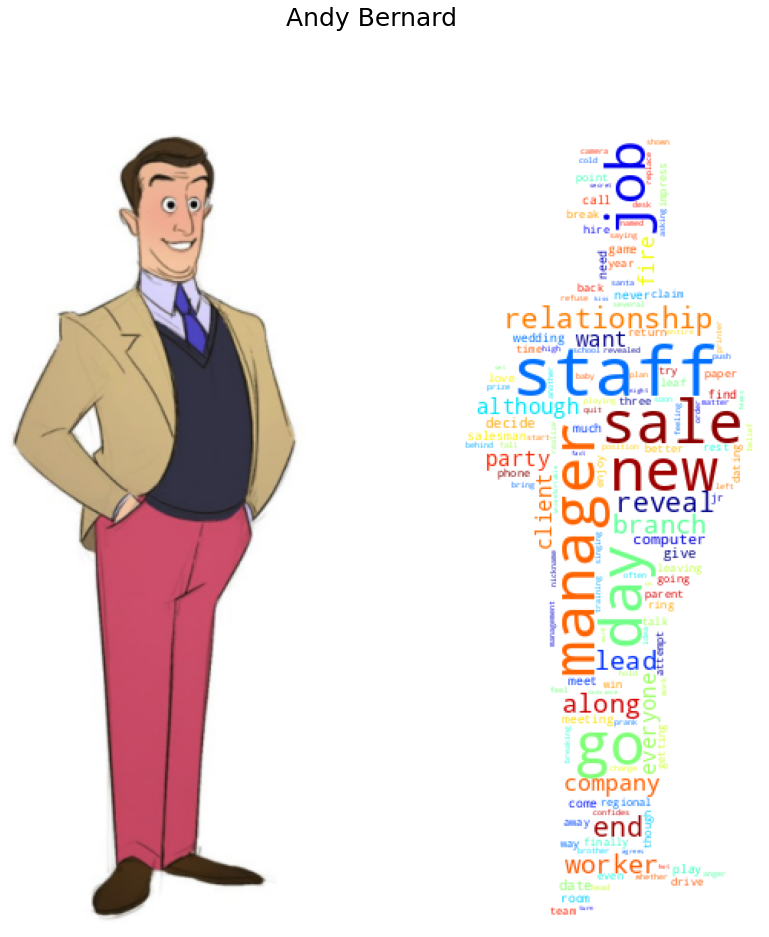

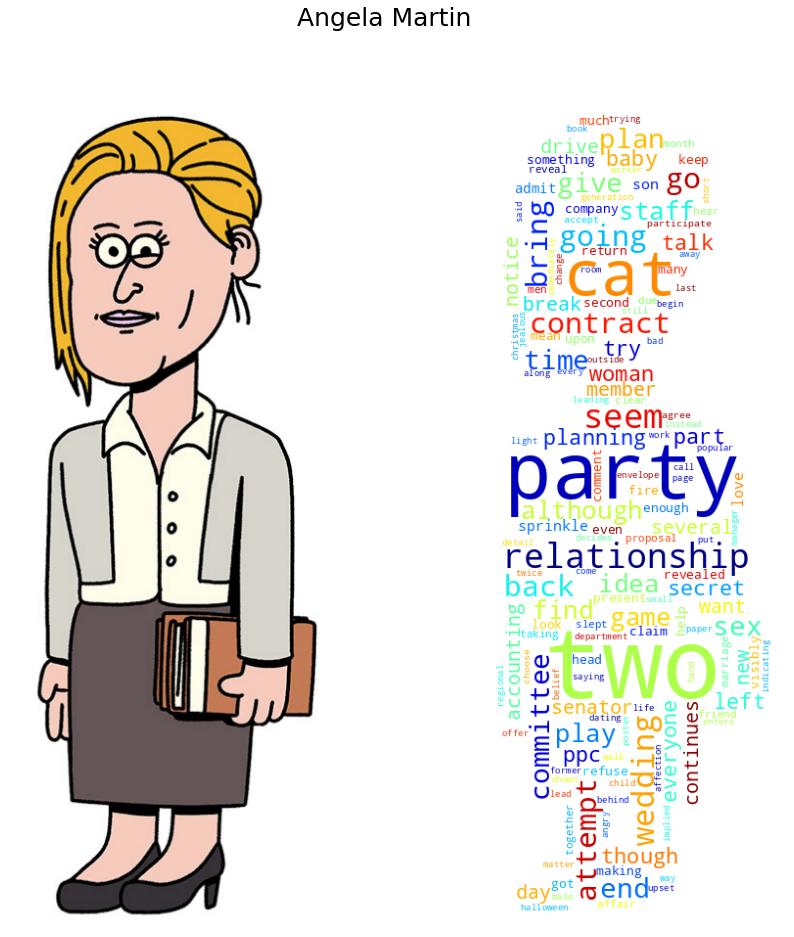

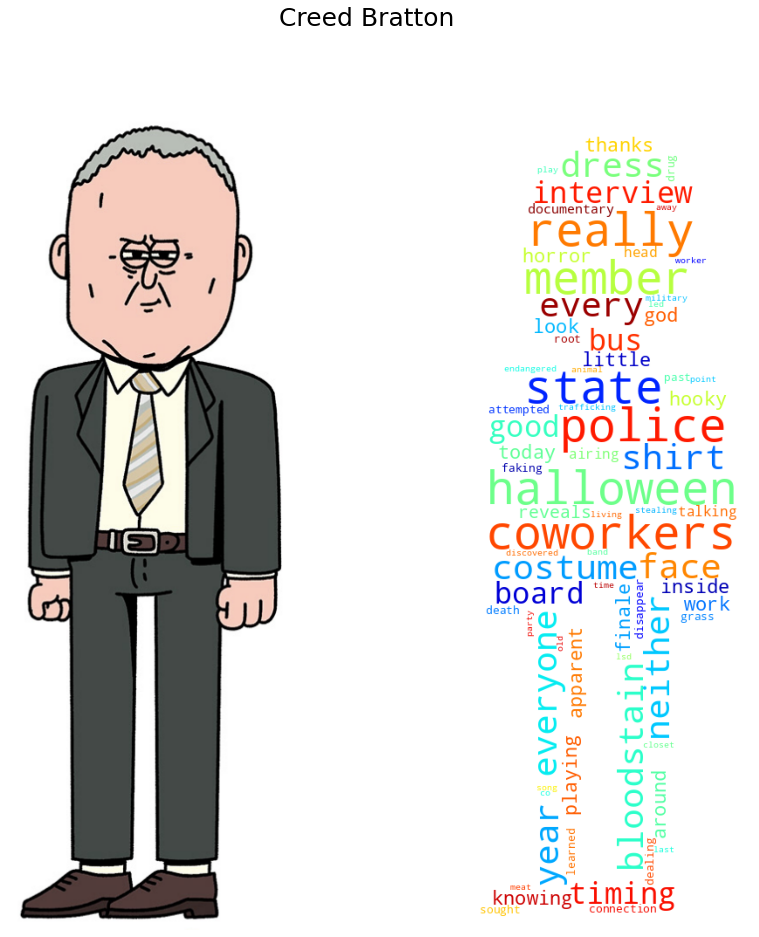

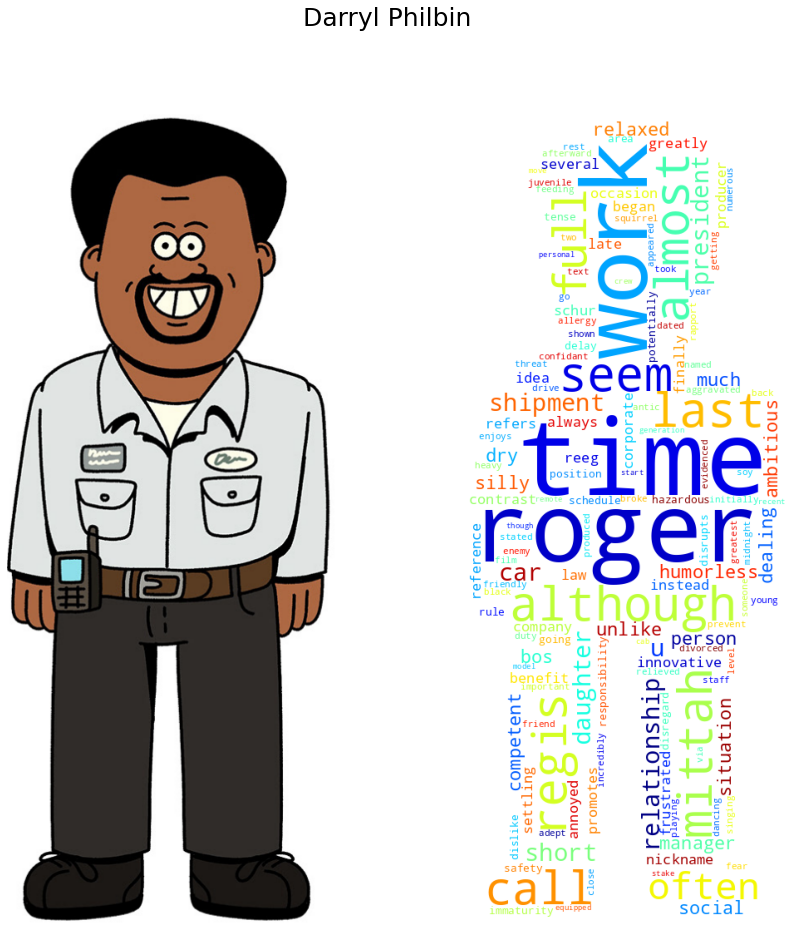

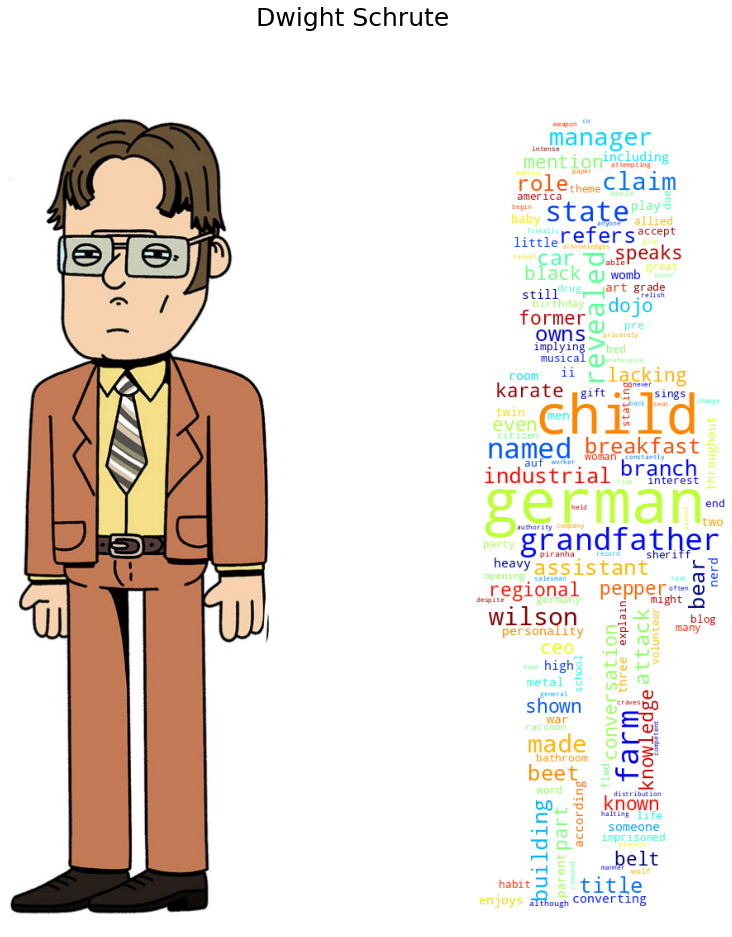

...

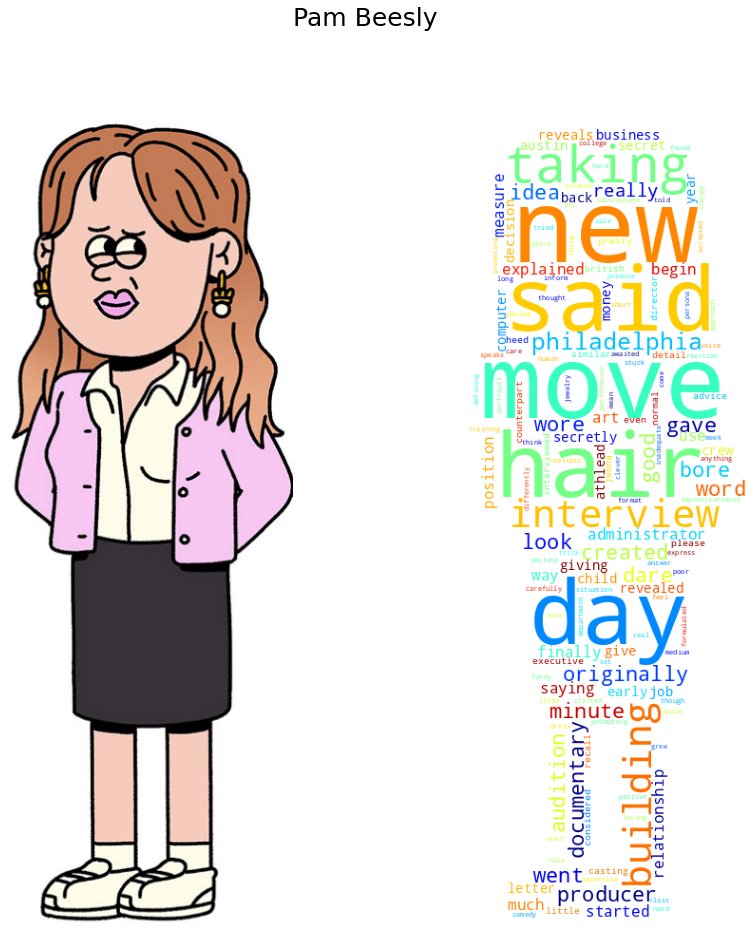

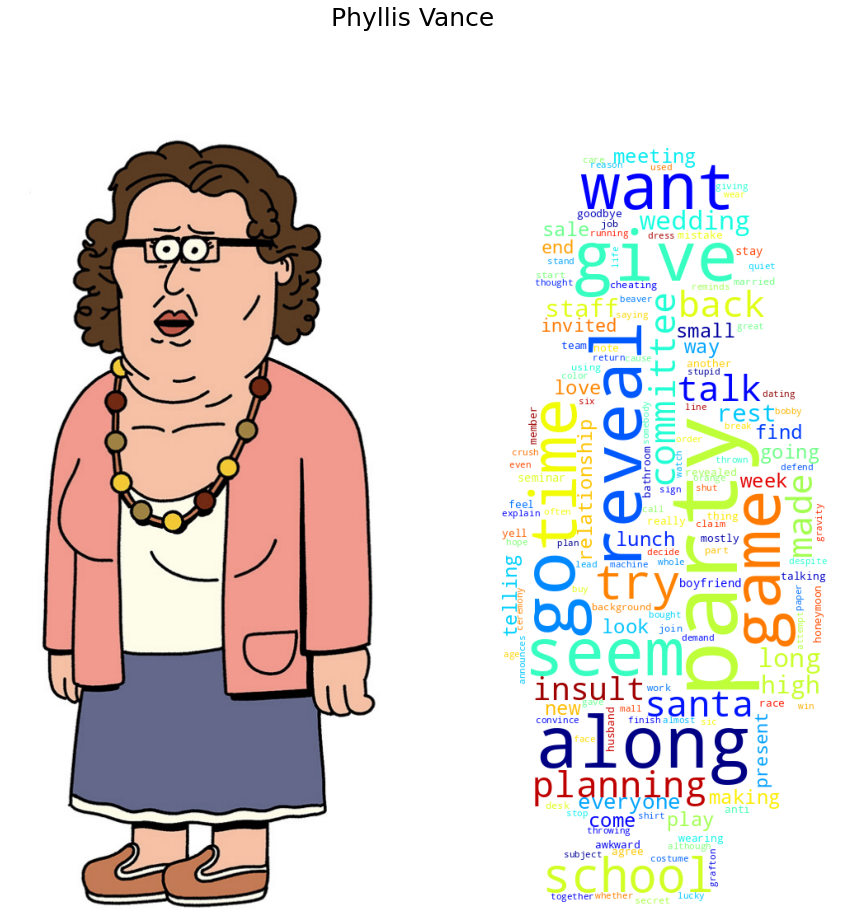

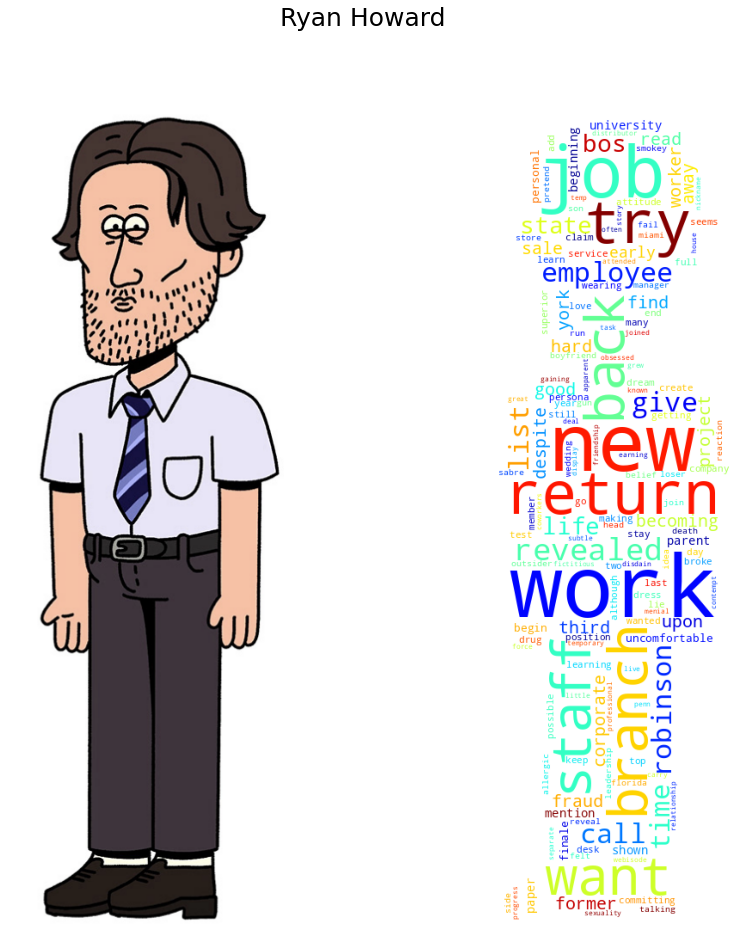

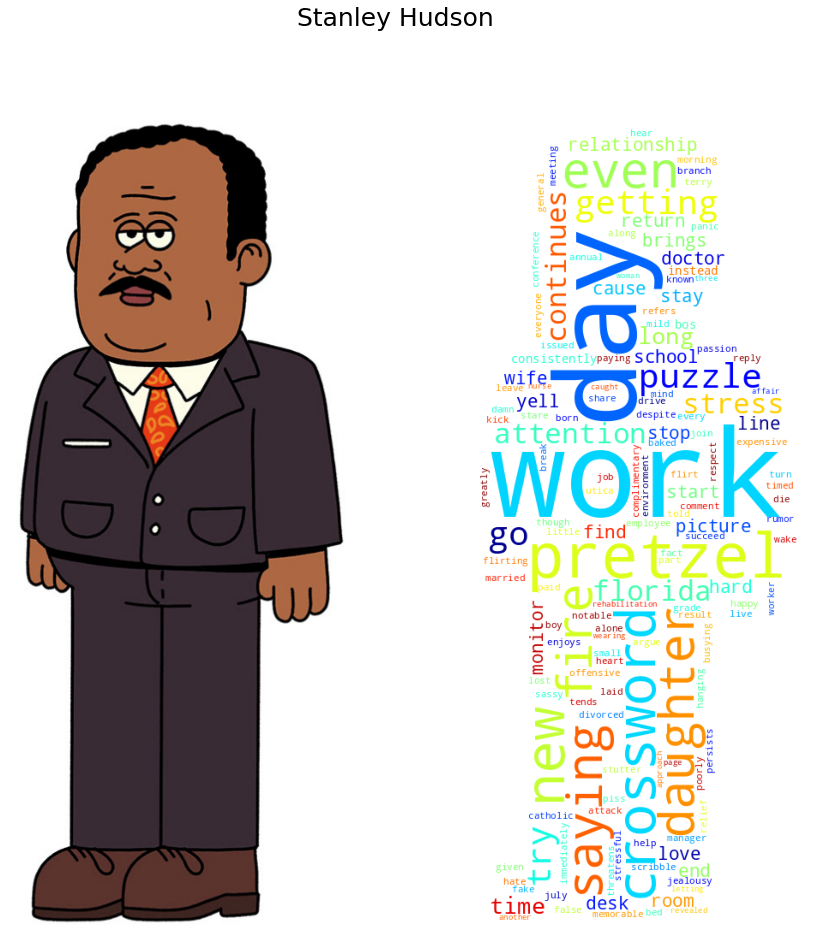

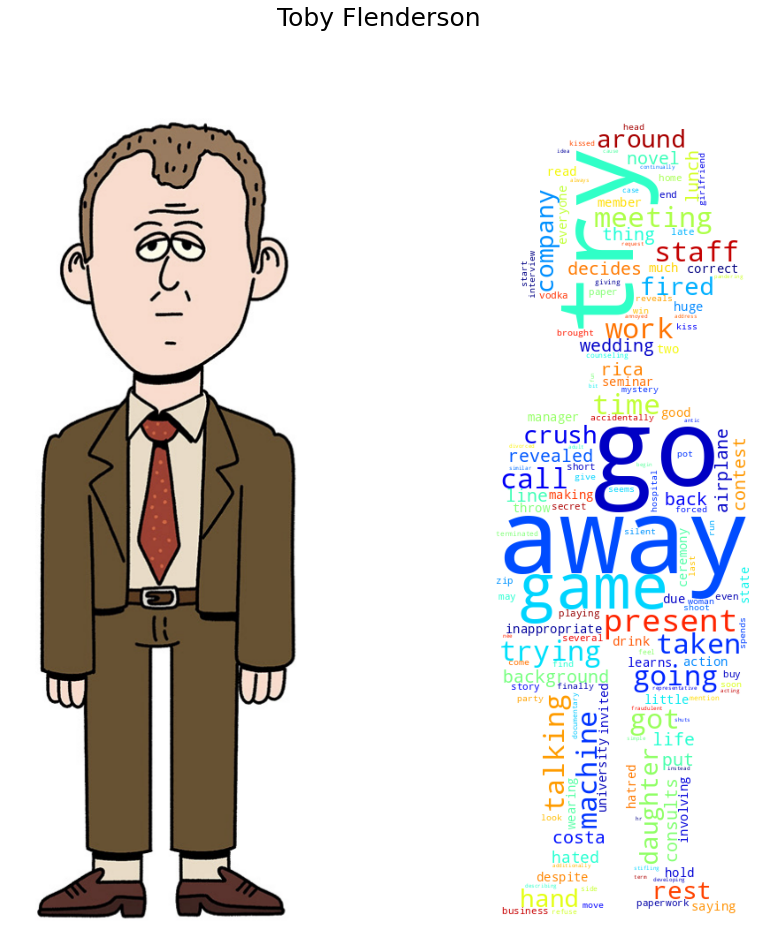

In [361]:
main_path = './masks/'

for name in wordcloud_strings.keys(): # loop through the keys of the wordcloud_strings dictionary
    plot_wordcloud(name, 'dunderpedia')

We can see that the wordclouds of the majority of characters include names of other characters, specially Michael's. Since The Office is based on conversations between co-workers, it makes sense that the most comon tokens are character names. However, the main names in each character wordcloud are related to their professional of intimate relations. For example: 
- Angela had an affair with Dwight while she was daiting Andy.  
- Jim is married to Pam and works close to Dwight.
- Kelly is in love with Ryan for most of the series. 
- Kevin works with Angela in the Accounting department.
- Roy Anderson was married to Pam before Jim. 

However, we can see that Dwight and Michael do not have any character names in their word-clouds. On the other hand, Dwight has his surname: `Schrute`. Thorught the seasons, he repeately shows that he is proud of being a Schrute. He also talkes a lot about the fact that he is german, and about the Shrute farm that belonged to his family in the past. 

### Basic Stats: IMDb <a class="anchor" id="stats_imdb"></a>

To better understand the data we are analysising, we will do some basic statistics with the IMDB dataframe. 

For all the analysis we have made use of `pandas` advanced built-in functions and `Plotly` library for interactive visualizations. We assume that the reader of this notebook is familiar with pandas, as we were thought to use it during the course and we will therefore not go into details on how the built-in functions work.  

### Episode Distribution<a class="anchor" id="imdb_episodes"></a>

We start by looking at the episodes per season. This will be useful when doing sentiment and word-cloud analysis of every season based on the transcripts. 

We use `pandas` and `Plotly` to analyse the results.

In [362]:
fig = px.bar(imdb_df, x='Season', y='Episode', 
             hover_name="EpisodeTitle",
             hover_data={'IMDBRating':':.2f', 
                         'AirDate': True,
                         'Viewership': True
                        },
             color='IMDBRating',  barmode='stack',
             title="Number of episodes per season", height=700)

fig.update_layout(yaxis={'showticklabels': False})
fig.show()
fig.write_json("plots/kaggle_imdb/01-episodes_per_season.json")

Season 1 had only 6 episodes. After this, the seasons tend to have between 22 and 26 episodes, except for season 4, which has only 14 episodes. The longest seasons, on the other hand, were season 5 and 6, with 26 episodes each. 

### Season Viewership<a class="anchor" id="imdb_season_viership"></a>

Analyse how the views have changed from season to season. We start by grouping the `imdb_df1` by `Season` and calculate the mean of the `Viewership` column. Then we use `Plotly` to interactively visualize our results.

In [363]:
viewership_seasons = imdb_df.groupby(['Season'])['Viewership'].mean().reset_index()

In [364]:
fig = px.line(viewership_seasons, x='Season', y='Viewership', text='Viewership',
             title="Average Viewership for each season", height=700)


fig.update_traces(marker=dict(size=12,
                              color='Orange',
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  textposition="bottom right", texttemplate = "%{text:.3s}")
fig.show()
fig.write_json("plots/kaggle_imdb/02-viewership_seasons.json")

The average Viewership has a consistent growth until season 5. After season 5, there is a steady decline in the views. The most signficant decline of views is from season 7 to season 8, after Michael left. So Michael had a big impact in the series. 

### Top 10 highest rated episodes<a class="anchor" id="imdb_top_10_rated"></a>

Next, we look at the 10 episodes that obtained the highest ratings using the `IMDBRating` and `TotalVotes` columns from the IMBD data.

In [365]:
top_10_rated = imdb_df.sort_values(by=['IMDBRating', 'TotalVotes']).iloc[-10:,:]

In [366]:
fig = px.bar(top_10_rated,x='IMDBRating', y='EpisodeTitle', text='IMDBRating', color='IMDBRating',
             hover_name="EpisodeTitle",
             hover_data={'Season':True,
                         'IMDBRating':':.2f', 
                         'AirDate': True,
                         'Viewership': True
                        },
             title="Top 10 rated episodes", orientation='h')

fig.update_yaxes(title_text="Episode Title")
fig.update_xaxes(title_text="IMDB Ratings")
fig.update_traces(texttemplate = "%{text:.3s}")
fig.show()
fig.write_json("plots/kaggle_imdb/03-top_10_rated_episodes.json")

The highest rated episodes are the Final episode, and Goodbye, Michael, in season 7, when michael leaves The Office. Both are rated with 9.8

<table><tr>
<td>Finale<img src="imgs/finale.gif"/> </td>
<td>Goodbye, Michael<img src="imgs/goodbye_michael.gif" /></td>
</tr></table>

### 10 most viewed episodes<a class="anchor" id="imdb_top_10_viewed"></a>

Next, we look at the 10 most viewed episodes using the `Viewership` column. 

In [367]:
most_viewed = imdb_df.sort_values(by=['Viewership']).iloc[-10:,:]

In [368]:
fig = px.bar(most_viewed, x='Viewership', y='EpisodeTitle', text='Viewership', color='Viewership',
             hover_name="EpisodeTitle",
             hover_data={'Season':True,
                         'IMDBRating':':.2f', 
                         'AirDate': True,
                         'Viewership': True
                        },
             title="10 most viewed episodes", orientation='h')

fig.update_yaxes(title_text="Episode Title")
fig.update_traces(texttemplate = "%{text:.3s}")
fig.show()
fig.write_json("plots/kaggle_imdb/04-most_10_viewed_episodes.json")

We can see that there are some similiarities in the most viewed and top rated episodes. Stress Relief is the most viewed episode of all seasons, and at the same time is the 3rd top rated episode. Then, Christmas Party and Niagara: Part 1, are both in the top 10 most viewed and top 10 rated episodes.

<table><tr>
<td>Stress Relief<img src="imgs/stress_relief.gif"/> </td>
<td>Niagara<img src="imgs/pam_wedding.gif" /></td>
</tr></table>


### Season Raiting<a class="anchor" id="imdb_season_rating"></a>

We want to analyse how the ratings changed from season to season. This will later be used when analizing the character sentiments, and their transcripts. We group the `imdb_df` data by `Season` and compute the mean of the `IMDBRating` column. Then visualize the results using `Plotly`.

In [369]:
rating_seasons = imdb_df.groupby(['Season'])['IMDBRating'].mean().reset_index()

In [370]:
fig = px.line(rating_seasons, x='Season', y='IMDBRating', text='IMDBRating',
             title="Average IMDB Rating for each season", height=700)


fig.update_traces(marker=dict(size=12,
                              color='Orange',
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  textposition="bottom right", texttemplate = "%{text:.3s}")

fig.update_yaxes(title_text="IMDB Ratings")
fig.show()
fig.write_json("plots/kaggle_imdb/05-rating_seasons.json")

We can see that there is an exponential rating growth from season 1 to 5. However, seasons 5 and 6 had a lower rating. And after Michael left, the ratings highly decreased, specially in season 8. We will see if the transcripts can explain this data. However, until now, the ratings and views distributions for the 9 seasons have shown that season 8 and 9 have been the least watched and rated seasons. Is Michael departure the reason?

### IMDB Ratings and Votes for each episode for every season<a class="anchor" id="imdb_rating_votes_seasons"></a>

The season rating analysis showed that the best rated seasons were 2, 3, 4 and 5, with a huge decrease after Michael left in the last episode of season 7. Now, we are going to perform a more detailed analysis by considering the IMDb rating for all the episodes in the Office. 

In [371]:
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(
        x = imdb_df.AirDate,
        y = imdb_df.IMDBRating, mode='lines+markers',
        marker_color = imdb_df.Season, 
        text=imdb_df.Season.map('Season {}'.format),
        name = "IMDB Rating")) 
 
fig.add_trace(
    go.Bar(
        x = imdb_df.AirDate,
        y = imdb_df.TotalVotes,
        name = "Votes",
        marker_color='rgba(0, 0, 100,0.2)'),
    secondary_y=True)

fig.add_annotation(x="1 Feb 2009", y=9.7,
            text="Stress Relief",
            showarrow=True,
            arrowhead=1)

fig.add_annotation(x="8 Oct 2009", y=9.5,
            text="Niagara episode <br>(Pam and Jim's wedding)",
            showarrow=True,
            arrowhead=1)

fig.add_annotation(x="28 Apr 2011", y=9.8,
            text="Good bye, Michael episode",
            showarrow=True,
            arrowhead=1)

fig.add_annotation(x="15 Mar 2012", y=6.6,
            text="Nellie joins the Scranton branch",
            showarrow=True,
            arrowhead=1)

fig.add_annotation(x="16 May 2013", y=9.8,
            text="Finale (Michael comes back)",
            showarrow=True,
            arrowhead=1)


fig.update_layout(
    title = 'IMDB Ratings and Votes for all episodes in The Office 9 season',
    xaxis_title="Air Date",
    width=1400,
    height=600,
    xaxis=dict(
        showline=True,
        showgrid=True,
        showticklabels=True,
#         linecolor='rgb(204, 204, 204)',
        linewidth=2,
        ticks='outside'
    ),
    yaxis=dict(
        showgrid=True,
        zeroline=True,
        showline=True,
        showticklabels=True,
        gridcolor='rgba(0, 0, 0,0.09)'
    ),
   
    plot_bgcolor='white'
)

fig.update_layout(hovermode="x unified")


fig.update_xaxes(nticks=20)
fig.update_yaxes(title_text="IMDB Rating", secondary_y=False)
fig.update_yaxes(title_text="Votes", secondary_y=True)
fig.show()
fig.write_json("plots/kaggle_imdb/06-imdb_ratings_votes_episodes.json")

The above plot offers a more clear representation of what we previously observed. The episodes until Good bye, Michael in season 7, obtain relatively high ratings. However, after Michael leaves, the episode rating is never as high as it was in previous seasons, until the last episode of season 9 'Finale', where Michael comes back.

The number of votes received is more or less the same throught all the episodes, and those episodes with high ratings obtain always high votes. However, all other episodes with rarings around or below 7, obtain around 4000-5000 votes on average.

### Guest starts in every season<a class="anchor" id="imdb_guest_stars"></a>

From time to time, guest stars appear in an episode. We would like to study if there is a relation between the number of guest stars that appear in a season, and the season rating. For this, first we look into the guest stars distribution by grouping the data by `Season` and counting the number of `GuestStars` in every season, we do so using `pandas`.

In [372]:
guest_starts = imdb_df.groupby(['Season'])['GuestStars'].count().reset_index()

In [373]:
fig = px.pie(guest_starts, values='GuestStars', names='Season', 
             title='Guest Stars distribution throughout the 9 seasons')

fig.update_layout(legend=dict({'traceorder': 'normal'}),legend_title_text='Season')
fig.show()
fig.write_json("plots/kaggle_imdb/07-guest_stars_distribution.json")

We can see that the number of Guest stars starts very low in the first season, but drastically grows in Season 2 to $20.7\%$. However, the number descreases again in seasons 3 and 4. Then it grows constantly during season 5 to 8 from $10.3\%$ and a maximum of $17.2\%$ in season 7. In the last season, the number of guest starts grows again to be the same as in season 2, $20.7\%$. 

Based on these statistics, we will now examine if the number of guest starts has an effect on the raiting of the seasons and the top rated episodes.

### Influence of Guest starts in season ratings<a class="anchor" id="imdb_guest_stars_ratings"></a>

Now we are going to put everything together. First, we start by looking if the number of guest stars had an influence in the ratings for all the 9 seasons:

In [374]:
fig = px.box(imdb_df, y ='IMDBRating', x ='Number of Guest Stars', color='Number of Guest Stars', 
             title='Ratings Distribution based on the Number of Guest Stars')
fig.update_layout(showlegend = False)
fig.update_yaxes(title_text="IMDB Ratings")
fig.show()
fig.write_json("plots/kaggle_imdb/08-ratings_distribution_guest_stars.json")

Episodes with a greater number of Guest Stars have higher raiting. As it can be seen from the above box plot, the median IMDb raiting is 9.15 when there were 4 guess stars, but only 8.2 when no guest stars appeared in the episode. This could explain why there was an increase in the number of stars in season 9. The producers could have thought that including more guest stars could increase the ratings of the season after the low ratings of season 8. 

However, conclusions cannot be made since the amount episodes containing guest starts is quite limited. However, there is a tendency for the ratings to go up as the number of guest stars increases. 

### Influence of the Guest stars in the season views<a class="anchor" id="imdb_guest_stars_views"></a>

We could see that there seems to be a relation between the season's ratings and the guest stars that appear in the season. We further look into the guest stars influence in the seasons popularity by contrasting the number of  guest stars with the season's views.

In [375]:
fig = px.box(imdb_df, y ='Viewership', x ='Number of Guest Stars', color='Number of Guest Stars', 
             title='Viewership Distribution based on the Number of Guest Stars')
fig.update_layout(showlegend = False)
fig.show()
fig.write_json("plots/kaggle_imdb/09-viewership_distribution_guest_stars.json")

Episodes with one guess star have a higher median rating that those with 0 guess stars. However, as the number of guess stars increases, the views do not neccessarily increse. The average viewership with 4 guess stars in an episode is less than those with one guess star. 

Hence, the guess stars influence the ratings but do not necessarily influence the views.

### Writers influence on the episode ratings<a class="anchor" id="imdb_writers_ratings"></a>

Throught the 9 seasons, episodes have been written by different people. Sometimes even by actors themselves. Let's look at the different writers aand the number of episodes they have writen.

In [376]:
office_writters_episode_count = imdb_df.groupby(imdb_df['Writers'].map(tuple))['EpisodeTitle'].count().to_dict()
sorted_office_writters_episode_count = {writter[0]: episode_count \
                                        for writter, episode_count in sorted(office_writters_episode_count.items(),
                                                                             reverse=True, key=lambda item: item[1])}

In [377]:
fig = go.Figure(
    data=[go.Bar(x=list(sorted_office_writters_episode_count.keys()), 
                 y=list(sorted_office_writters_episode_count.values()),
                 text=list(sorted_office_writters_episode_count.values()))],
    layout=go.Layout(
        title=go.layout.Title(text="Episodes written by all the writers of The Office"),
        xaxis_title="Writer",
        yaxis_title="Number of episodes written"
    )
)

fig.show()
fig.write_json("plots/kaggle_imdb/10-writers_episodes.json")

The three writers who have written the most episodes along the nine seasons are in fact 3 of the main characters of The Office. 

<table><tr>
<td>Mindy Kaling (Kelly)<img src="imgs/kelly_smart1.gif" width=300 height=300 /></td>
<td>B.J.Novak (Ryan)<img src="imgs/ryan.gif" width=300 height=300/> </td>
<td>Paul Lieberstein (Toby)<img src="imgs/toby.gif"width=350 height=300/> </td>
</tr></table>

Kelly has written 20 episodes, Ryan 15 and Toby 13. 

Let's now look into how the episodes writen by these characters are rated according to IMDb:

In [259]:
writer_avg_rating = imdb_df.groupby(imdb_df['Writers'].map(tuple))['IMDBRating'].mean().to_dict()
sorted_writer_avg_rating = {writter[0]: rating \
                                        for writter, rating in sorted(writer_avg_rating.items(),
                                                                             reverse=True, key=lambda item: item[1])}

In [378]:
fig = go.Figure(
    data=[go.Bar(x=list(sorted_writer_avg_rating.keys()), 
                 y=list(sorted_writer_avg_rating.values()),
                 marker_color=list(sorted_writer_avg_rating.values()),
                 text=list(sorted_writer_avg_rating.values()),
                 texttemplate = "%{text:.3s}")],
    
    layout=go.Layout(
        title=go.layout.Title(text="Average Rating for episodes writen by each writer"),
        xaxis_title="Writer",
        yaxis_title="Average IMDb Rating"
    )
)

fig.show()
fig.write_json("plots/kaggle_imdb/11-writers_average_episode_ratings.json")

The episodes written by Greg Daniels, an american screenwriter, are the top rated episodes. However, in second place we can find the episodes writen by Paul Lieberstein, the actor Toby in the series. This shows that he is not only a good actor, but also a talented writer. His episodes are averaged rated with 9.3/10. 

The episodes written by Ryan and Kelly are rated with 8.33 and 8.31, respectively. One point difference from Toby's episodes. 

Hence, Kelly (Mindy Kaling) and Toby (Paul Liberstein) are the top two writers in terms of the number of episodes they have written.

### Director influence on the episode ratings<a class="anchor" id="imdb_directors_ratings"></a>

Similarly to the above analysis, the episodes have been directed by different people, also including the actors themselves.

In [379]:
director_episode_count = imdb_df.groupby('Director').count().reset_index()

In [380]:
fig = px.bar(director_episode_count, x='Director', y='EpisodeTitle', text='EpisodeTitle', 
             title="Episodes directed by all the directors of The Office", width=1200)

fig.update_yaxes(title_text="Episode Title")
fig.show()
fig.write_json("plots/kaggle_imdb/12-directors_episodes.json")

In [381]:
director_avg_rating = imdb_df.groupby('Director')['IMDBRating'].mean().reset_index().\
                    sort_values('IMDBRating',ascending=True)

In [382]:
fig = px.bar(director_avg_rating, y='Director', x='IMDBRating', color='IMDBRating', text='IMDBRating', 
             title="Average Rating for episodes directed", orientation='h', height=1400)
fig.update_traces(texttemplate = "%{text:.3s}")

fig.update_xaxes(title_text="IMDB Ratings")
fig.show()
fig.write_json("plots/kaggle_imdb/13-directors_average_episode_ratings.json")

Let's peek into the top 10 rated episodes previously found to be able to draw conclusions on the director ratings:

In [383]:
top_10_rated

,Season,Episode,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description,Viewership,GuestStars,Director,Writers,Number of Guest Stars
64,4,14,"Goodbye, Toby",9.4,5683,15 May 2008,Michael throws an extravagant going-away party...,8.07,NaN,Paul Feig,"[Jennifer Celotta , Paul Lieberstein]",0
94,6,4,Niagara: Part 1,9.4,6354,8 Oct 2009,The Office travels to Niagara Falls to celebra...,9.42,NaN,Paul Feig,"[Greg Daniels , Mindy Kaling]",0
27,2,22,Casino Night,9.4,6813,11 May 2006,The Dunder Mifflin crew holds a casino party a...,7.60,NaN,Ken Kwapis,[Steve Carell],0
132,7,16,Threat Level Midnight,9.4,7385,17 Feb 2011,"Michael finally finishes his movie ""Threat Lev...",6.41,NaN,Tucker Gates,[B. J. Novak],0
95,6,5,Niagara: Part 2,9.5,5221,8 Oct 2009,Pam is forced to deal with an embarrassing inj...,9.42,NaN,Paul Feig,"[Greg Daniels , Mindy Kaling]",0
186,9,22,A.A.R.M.,9.5,6030,9 May 2013,Dwight prepares for a marriage proposal and hi...,4.56,NaN,David Rogers,[Brent Forrester],0
59,4,9,Dinner Party,9.5,8372,10 Apr 2008,Michael invites Jim and Pam and Andy and Angel...,9.22,NaN,Paul Feig,"[Gene Stupnitsky , Lee Eisenberg]",0
77,5,13,Stress Relief,9.7,12116,1 Feb 2009,Dwight's too-realistic fire alarm gives Stanle...,22.91,"Cloris Leachman, Jack Black, Jessica Alba",Jeffrey Blitz,[Paul Lieberstein],3
137,7,21,"Goodbye, Michael",9.8,12477,28 Apr 2011,As the office gets ready for Michael's final d...,8.42,NaN,Paul Feig,[Greg Daniels],0
187,9,23,Finale,9.8,15495,16 May 2013,"One year later, Dunder Mifflin employees past ...",5.69,"Joan Cusack, Ed Begley Jr, Rachel Harris, Nanc...",Ken Kwapis,[Greg Daniels],4


Randall Einhorn and Paul Feig have directed the most number of episodes. At the same time, looking at the top 10 rated episodes we can see that Paul has directed 5 out of the top most rated episodes: Goodbye Michael, Goodbye Toby, Niagara:Part 1 and 2 and Dinner party. However, Randall has not directed any of the top 10 rated episodes.

On the other hand, Steve Carell, who plays as Michael, has the highest Average Rating for all his directed episodes. Although he has only directed 3 episodes.

### Cast Director influence on the episode ratings<a class="anchor" id="imdb_cast_director_ratings"></a>

Let's now directly look into those members of the cast who have been involved in directing episodes of The Office. Let's look at their raitings individually:

In [384]:
cast_directors = ['Paul Lieberstein', 'B.J. Novak','Steve Carell', 'John Krasinski','Rainn Wilson','Mindy Kaling', 'Michael Schur']
cast_director_episode_count = director_episode_count.loc[director_episode_count.Director.isin(cast_directors)]
cast_director_avg_rating = director_avg_rating.loc[director_avg_rating.Director.isin(cast_directors)]

In [385]:
fig = make_subplots(rows=2, cols=1, 
                    subplot_titles=("Episodes directed by the cast of The Office",
                                    "Average Rating for episodes directed by the cast of The Office")
                   )

fig.add_trace(
    go.Bar(x=cast_director_episode_count['EpisodeTitle'], y=cast_director_episode_count['Director'], 
           text=cast_director_episode_count['EpisodeTitle'],
    orientation='h'),
    row=1, col=1,
)


fig.add_trace(
    go.Bar(x=cast_director_avg_rating['IMDBRating'], y=cast_director_avg_rating['Director'],
           marker_color=cast_director_avg_rating['IMDBRating'],texttemplate = "%{text:.3s}",
           text=cast_director_avg_rating['IMDBRating'], orientation='h'),
    row=2, col=1)


fig['layout']['xaxis']['title']='Number of episodes directed'
fig['layout']['xaxis2']['title']='Average IMDB Ratings'
fig['layout']['yaxis']['title']='Cast Director'
fig['layout']['yaxis2']['title']='Cast Director'
# fig.update_traces(texttemplate = "%{text:.3s}")

fig.update_layout(height=800, width=900, showlegend=False, title_text="Episodes and their ratings directed by the cast of The Office")
fig.show()
fig.write_json("plots/kaggle_imdb/14-episodes_rating_directed_by_cast.json")

Steve Carell, Michael, has the highest average rating for the 3 episodes he has directed, followed by Mindy Kaling, Kelly, who has directed 2 episodes. 

Out of the 6 actors who directed episodes, the worst performing ones were the ones directed by John Krasinski, Jim, who directed 3 episodes. 

Paul Lieberstein and B.J.Novak are the ones who have been involved the most in the directing and writing of episodes. They have directed 7 and 5 episodes, respectively. And they have written 15 and 13 episodes, respectively. We can conclude however, that Paul Lieberstein is better at writing episodes, than at directing them.

### Basic Stats: Kaggle:  The Office (US) - Complete Dialogue/Transcript <a class="anchor" id="stats_transcripts"></a>

### Character summary of lines spoken and episodes acted<a class="anchor" id="transcripts_lines_episodes"></a>

We start our analysis on the transcript dataset by looking at the line distribution between characters through seasons and the number of episodes where each character acted. We again look at the 25 main characters identified fom the Dunderpedia Wiki. 

For this, we group the transcripts by speaker and count their lines. For the episodes, we group them by speaker and season and count the number of episodes where that character has lines.

In [386]:
# group each speaker to lines (said by that speaker)
transcripts_df_grouped = main_character_transcripts_df.groupby(by='speaker')['line'].count().reset_index().sort_values('line', ascending=False)

In [387]:
episodes_df_grouped = main_character_transcripts_df.sort_values(['season','episode','scene'])\
            .drop_duplicates(['season','episode','speaker'],keep='first')\
            .groupby('speaker')['episode'].count().reset_index()

Let's now see how many lines the main characters have and in how this varies from season to season:

In [388]:
percents = (transcripts_df_grouped.line/transcripts_df_grouped.line.sum()*100).tolist() #percent wrt lines spoken
episode_percents = (episodes_df_grouped.episode/len(imdb_df)*100).tolist() #percent wrt lines spoken

In [389]:
fig = make_subplots(rows=2, cols=1,vertical_spacing=0.04, shared_xaxes=True, 
                    subplot_titles=("Lines said by the main characters of The Office",
                                    "Episodes where the main characters acted"))

fig.add_trace(
    go.Scatter( 
        x=transcripts_df_grouped.speaker, 
        y=transcripts_df_grouped.line,
        line=dict(color='red', width=2.5),
        hovertemplate= "<b>%{x}</b> spoke <b>%{y}</b> lines"+
        " %{text}",
        name='lines said',
        text = ['<br>a total contribution of 'f"<b>{v:.2f}%</b> in The Office"  for v in percents],
        mode='lines+markers',  showlegend=False
    ),row=1, col=1)


fig.add_trace(
    go.Bar( 
        x=episodes_df_grouped.speaker, 
        y=episodes_df_grouped.episode,
        marker_color='rgb(21, 129, 191)',
        hovertemplate= "<b>%{x}</b> acted in <b>%{y}</b> episodes"+
        " %{hovertext}",
        name='episodes acted',
        text=episodes_df_grouped.episode,
        hovertext = ['<br>a total contribution of 'f"<b>{v:.2f}%</b>"  for v in episode_percents],  
        showlegend=False
    ),row=2, col=1)

fig.update_traces(xaxis='x2')
fig.update_layout(height=1000, hovermode="x unified", title="Character summary of lines spoken and episodes acted")

fig['layout']['yaxis']['title']='Number of lines said'
fig['layout']['yaxis2']['title']='Number of episodes acted'
fig['layout']['xaxis2']['title']='Character'

fig.show()
fig.write_json("plots/kaggle_imdb/15-line_count_main_characters.json")

* **Michael Scott**, the main character and Regional Manager of the Scranton branch is the character with the most lines, and highest **contribution of 22.43%**, even though he left The Office in season 7, and hence did not participate in the last two seasons. At the same time, he participates in only 73% of the episodes, quite less in comparison to **Dwigth Schrute**, assistant (to the) regional manager, which appeared in 98.4% of the episodes, but **contributes 14.09%**, **8.35% less than Michael** and has acted in 49 more episodes than Michael!

* Looking at their contribution percentage, we can see that **Michael, Dwight, Jim** (salesman), **Pam** (receptionist) and **Andy** (salesman and regional manager in season 8)** are the top contributors. However, the other 20 supporting characters starting from **Kevin until Pete** contibute much less than the 5 main characters, ranging from **3.21% from Kevin to 0.44% from Pete**. 

Now, we will analyse the line count by season for each of the main characters, and see who is the main character after Michael left. 

In [390]:
fig = make_subplots(rows=3, cols=3,vertical_spacing = 0.07,
                    x_title='line count',
                    y_title='character',
                    subplot_titles=('Season 1', 'Season 2', 'Season 3', 'Season 4', 'Season 5', \
                                                   'Season 6', 'Season 7', 'Season 8', 'Season 9'))

for i, season in enumerate(main_character_transcripts_df['season'].unique()):# loop through the keys of the wordcloud_strings dictionary (every race) 
    transcripts_df_season = main_character_transcripts_df. \
            loc[main_character_transcripts_df['season'] == season] \
            .groupby(by='speaker')['line'].count().reset_index().sort_values('line')
    
    trace = go.Bar(x=transcripts_df_season['line'], y=transcripts_df_season['speaker'],
                   name=f'lines season {season}',
               text=transcripts_df_season['line'], orientation='h')
    fig.add_trace(trace, row = (i//3)+1 , col = (i%3)+1)
    
fig.update_layout(height=1500, width=1200, showlegend=False, 
                  title_text="Line distribuion for all seasons", hovermode="x unified")

fig.show()
fig.write_json("plots/kaggle_imdb/16-line_distribution_seasons.json")

* We can see that **Michael** is the main character in all the 7 seasons where he participates. The second place is shared by **Dwigth and Jim** through the first 8 seasons. In season 8, **Andy** gets promoted to regional manager, to replace Michael, and hence, he is the character with the most lines in that season. However, in season 9, it is **Dwight** who gets promoted to regional manager. Hence, he is the dominant character with the most lines in that season. We can therefore see a pattern, the regional manager of the Scranton branch is always the character with the most lines.


* This is related to the analysis done with the IMDB ratings. Season 8, after Michael left, is rated as the worst season. This can also be influenced by the fact that Michael's replacement was Andy, who is known not to be liked by the audience. After season 8, Andy was replaced in the role of regional manager by Dwigth, and the ratings went up slightly. Can it be that the writers noticed that Andy was not liked by the audience? We will try to answer this question in the next analyses.

### Share of dialogue throughout the series<a class="anchor" id="transcripts_share_dialogs"></a>

Next, we look into the average number of lines each main character said each episode per season. For each  main character, we filter the `transcripts_df` and select the lines said by that character. Then we group them by season and count them using `pandas`. 

For every character, we create a Scatter plot using `Plotly`. 

In [391]:
character_names = transcripts_df_grouped.sort_values('line', ascending=False).speaker
fig = make_subplots(rows=5, cols=5,vertical_spacing = 0.07,
                    x_title='season',
                    y_title='line count',
                    subplot_titles=tuple(character_names))

for i, character in enumerate(character_names):# loop through the keys of the wordcloud_strings dictionary (every race) 
    transcripts_df_character = main_character_transcripts_df. \
            loc[main_character_transcripts_df['speaker'] == character] \
            .groupby(by='season')['line'].count().reset_index()
    
    trace = go.Scatter(x=transcripts_df_character['season'], y=transcripts_df_character['line'], 
                       name=character,
                       hovertemplate='Season <b>%{x}</b>: <b>%{y}</b> lines said', fill='tozeroy')
    fig.add_trace(trace, row = (i//5)+1 , col = (i%5)+1)
    
fig.update_xaxes(range = [1,9], dtick=1)
fig.update_layout(height=1500, width=1200, showlegend=False, 
                  title_text="Character line distribution throught seasons",
                  hovermode="x unified")
fig.show()
fig.write_json("plots/kaggle_imdb/17-characters_line_distribution_seasons.json")

* **Michael, Dwigth, Jim and Pam** are the ones with the highest contributions for all the seasons. However, After Michael left in season 7, **Dwight, Jim, Pam and Andy** contribute more. In fact, the dialog contibution is more spread and less focused on one single character (Michael), and other characters such as **Kevin, Angela, Oscar or Erin** have more lines in the last two seasons. On the contrary, Jan losses protagonism after season 5 when she losses the position as a manager. 


* Besides, **Darryl** experiences an increase in his dialogue after he moves from the warehouse to the main office in season 7. Then, other primary characters such as **Angela, Kevin, Oscar, Toby, Phyllis, Kelly, Meredith and Stanley** have a consistent growth from season 5. 

### Top speaker influence in the episode raiting<a class="anchor" id="transcripts_top_speakers_ratings"></a>

We saw, on average, Michael is the top speaker for the 7 seasons where he participates. Now, we want to further investigate if there is a relation between the top speaker in every episode of every season, and that episode IMDb raiting. 

In order to achieve this, we create a new dataframe `top_speakers_df`, where we compute the top speaker for every episode of every season. The top speaker is calculated by summing up their lines during that episode. 

In [392]:
top_speakers = {'Season': [], 'Episode': [], 'Top speaker': []}

for season in imdb_df['Season'].unique():
    imdb_seasons = imdb_df.loc[imdb_df['Season'] == season]
    
    for episode in imdb_seasons['Episode'].unique():
        try:
            transcripts_df_grouped = main_character_transcripts_df[(main_character_transcripts_df['season'] == season) \
                        & (main_character_transcripts_df['episode'] == episode)] \
                .groupby(by='speaker')['line'].apply(list).to_dict()

            sorted_line_count = {character: len(lines) for character, lines in sorted(transcripts_df_grouped.items(), reverse=True, key=lambda item: len(item[1]))}
            top_speaker = list(sorted_line_count.keys())[0]

            top_speakers['Season'].append(season)
            top_speakers['Episode'].append(episode)
            top_speakers['Top speaker'].append(top_speaker)
        except: # the Kaggle dataset is missing lines for some episodes
            continue

Once we have the top speakers dataframe in place, we merge it with the IMDb data we obtained from Kaggle, and we use the `plotly` library to plot the ratings distribution based on the top speakers.

In [393]:
top_speakers_df = pd.DataFrame.from_dict(top_speakers)
top_speakers_and_ratings_df = pd.merge(top_speakers_df, imdb_df, 
                                    on=['Season', 'Episode'])
top_speakers_and_ratings_df.head()

,Season,Episode,Top speaker,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description,Viewership,GuestStars,Director,Writers,Number of Guest Stars
0,1,1,Michael,Pilot,7.4,7134,24 Mar 2005,The premiere episode introduces the boss and s...,11.2,NaN,Ken Kwapis,"[Ricky Gervais , Stephen Merchant and Greg Dan...",0
1,1,2,Michael,Diversity Day,8.3,7033,16 Mar 2005,Michael's off color remark puts a sensitivity ...,6.0,NaN,Ken Kwapis,[B. J. Novak],0
2,1,3,Dwight,Health Care,7.7,5863,5 Apr 2005,Michael leaves Dwight in charge of picking the...,5.8,NaN,Ken Whittingham,[Paul Lieberstein],0
3,1,4,Michael,The Alliance,8.0,5673,12 Apr 2005,"Just for a laugh, Jim agrees to an alliance wi...",5.4,NaN,Bryan Gordon,[Michael Schur],0
4,1,5,Michael,Basketball,8.4,6299,19 Apr 2005,Michael and his staff challenge the warehouse ...,5.0,NaN,Greg Daniels,[Greg Daniels],0


In [394]:
fig = px.box(top_speakers_and_ratings_df, y ='IMDBRating', x ='Top speaker', color='Top speaker', 
             title="Ratings Distribution based on the Episodes' Top Speakers")

fig.update_yaxes(title_text="IMDB Ratings")
fig.show()
fig.write_json("plots/kaggle_imdb/18-ratings_distribution_top_speakers.json")

For all episodes in the 9 seasons, 7 main speakers were identified. 

As we previously suspected, when Michael is the top speaker in an episode, that episode tends to obtain higher ratings. 

However, when Andry speaks, the episode ratings are lower. Hence, this explains the low ratings of season 7. However, in season 8, Andy was replaced as Regional Manager by Dwigth, who also tends to obtain low raitings, an average of 7.8 in comparison to 7.7 from Andy. Hence, this also explains why the ratings of season 9 were low. 

A smarter choice would have been to replace Andry with Jim, which has almost the same success rate when it comes to high episode ratings as Michael.

Nelly is also the main speaker in some episodes, and although there is not enough data to draw conclusions, the episode were she is the top speaker, obtains a relatively low rating, 6.5, in comparison to the other top speakers.

### Top speaker influence in the episode Viewership <a class="anchor" id="transcripts_top_speakers_views"></a>

Let's repeat the previous analysis, but this time let's analyse the influence of the top speaker in episode views.

In [395]:
fig = px.box(top_speakers_and_ratings_df, y ='Viewership', x ='Top speaker', color='Top speaker', 
             title="Viewership Distribution based on the Episodes' Top Speakers")
fig.update_layout()
fig.show()
fig.write_json("plots/kaggle_imdb/19-viewership_distribution_top_speakers.json")

Once again, Michael and Jim have a positive influence in the views when they are the top speakers of the episodes. However, when Pam is the top speaker, the views are the lowest. This might be because generally she does not make many jokes and she is more calm, so people could see her as boring. 

On the other hand, Dwight has a very specific sense of humor. He is very sarcastic, and not many viewers might understand and/or like it. 

### How many times the charactes say their favourite sentences?<a class="anchor" id="transcripts_jokes"></a>

Having watched the office, we cannot help but to analyse the most popular sentences that identify the main characters. 

#### That's what she said

<img src="imgs/michael.gif"/>


Let's start by looking at Michaels most popular joke: *That's what she said*. 

Since this joke became so popular, we will start by looking at which characters said it throughout all the 9 seasons.

In [69]:
thats_what_she_said = transcripts_df[transcripts_df['line'].str.contains("that's what she said", 
                                                        flags=re.IGNORECASE, regex=True)]
thats_what_she_said

,season,episode,title,scene,speaker,line
1887,2,2,Sexual Harassment,306,Michael,That's what she said. Pam?
1933,2,2,Sexual Harassment,316,Jim,Does that include 'That's What She Said'?
1936,2,2,Sexual Harassment,316,Michael,THAT'S WHAT SHE SAID!
3973,2,10,Christmas Party,621,Michael,"A, that's what she said, and B, I wanted it to..."
4791,2,12,The Injury,752,Dwight,That's what she said.
5841,2,17,Dwight's Speech,953,Michael,That's what she said!
6818,2,21,Conflict Resolution,1128,Michael,"That's what she said. The thing is, Angela......"
7469,3,1,Gay Witch Hunt,1264,Michael,I am glad that today spurred social change. Th...
10030,3,10,A Benihana Christmas (Parts 1&2),1683,Michael,Oh. That's what she said.
10598,3,13,Traveling Salesmen,1781,Dwight,That's what she said.


In [70]:
thats_what_she_said_count = thats_what_she_said.groupby('season')['speaker'].count().reset_index()

In [71]:
fig = px.bar(thats_what_she_said_count, y='season', x='speaker', text='speaker', 
             title="That's what she said jokes in the 9 seasons", orientation='h')
fig.update_layout(
    xaxis_title="number of jokes")
fig.show()
fig.write_json("plots/kaggle_imdb/20-thats_what_she_said.json")

The number of That's what she said jokes starts in season 2 and grows until season 4, then the joke is not said so often anymore. In season 8, when Michael leaves, no one says it. 

Then, in season 9, it is said again Once by Michael and once by Creed. 

Let's now look into how says it the most:

In [72]:
thats_what_she_said_df = thats_what_she_said['speaker'].value_counts().reset_index()
thats_what_she_said_df.columns = ['Speaker', 'Number of Times Said']
thats_what_she_said_df = thats_what_she_said_df.sort_values('Number of Times Said')

fig = px.scatter(thats_what_she_said_df, x='Speaker', y='Number of Times Said', 
                 color='Speaker', text='Number of Times Said', 
             title="That's what she said jokes and who says it")

fig.update_traces(marker_size=25)
fig.update_layout(
    xaxis_title="number of jokes")
fig.show()
fig.write_json("plots/kaggle_imdb/21-thats_what_she_said_characters.json")

In [74]:
plot_fig(int(thats_what_she_said_df.loc[thats_what_she_said_df['Speaker'] == 'Michael']['Number of Times Said']), 
         "Number of times Michael says: That's what she said", 'kaggle_imdb/22-thats_what_she_said_michael')

#### Dunder Mifflin, this is Pam

As the receptionist, for the first 4 seaons, whenever Pam was answering the phone, she always said: 'Dunder Mifflin, this is Pam'. Let's look into how many times she actually said it:
<img src="imgs/pam.gif" width=600/>


In [76]:
dunder_miffin_pam = transcripts_df[transcripts_df['line'].str.contains("Dunder Mifflin, this is Pam|Dunder Mifflin this is Pam", 
                                                        flags=re.IGNORECASE, regex=True)]

In [78]:
plot_fig(dunder_miffin_pam.shape[0], 
         'Number of times Pam said: Dunder Mifflin, this is Pam', 'kaggle_imdb/23-dunder_mifflin_pam')

#### Number of times Angela talks about her Cats

Angela loves cats. We found the name of her cats in the Dunderpedia page: [Angela's cats](https://theoffice.fandom.com/wiki/Angela%27s_cats), and we counted the times she said `cat`, `cats`, or any of the 18 names cats she has or has had.

<img src="imgs/angela.gif" width=500/>


In [80]:
angela_cats = transcripts_df[transcripts_df['line'].str.contains("cat|cats|Sprinkles|Garbage"+\
                                                                 "|Bandit|Princess Lady|Mr. Ash|Petals|Comstock"+\
                                                                 "Ember|Milky Way|Diane|Lumpy|Philip|Tinkie"+\
                                                                 "Crinklepuss|Pawlick Baggins|Lady Aragorn", 
                                                        flags=re.IGNORECASE, regex=True)]
angela_cats = angela_cats.loc[angela_cats['speaker'] == 'Angela']

In [81]:
plot_fig(angela_cats.shape[0], 
         'Number of times Angela talks about her cats', 'kaggle_imdb/24-angela_cats')

### Number of times Andy calls Jim Tuna

Andy Bernard had a habit of using the nickname "Big Tuna" when referring to Jim Halpert. Let's see how many times she says it throughout the seasons:

<img src="imgs/andy_tuna.gif" width=400 height=300/>

In [83]:
andy_tuna = transcripts_df[transcripts_df['line'].str.contains("tuna", 
                                                        flags=re.IGNORECASE, regex=True)]
andy_tuna = andy_tuna.loc[andy_tuna['speaker'] == 'Andy']

In [84]:
plot_fig(andy_tuna.shape[0], 
         'Number of times Andy calls Jim Tuna', 'kaggle_imdb/25-andy_big_tuna')

#### Number of times Kelly calls or talls about Ryan

Kelly is deeply in love with Ryan. However, Ryan tried to break up with Kelly multiple times unsuccessfully. Let's see how many times Kelly calls Ryan, and vice-versa.

<img src="imgs/kelly.gif" width=600 height=400/>

In [89]:
kelly_ryan = transcripts_df[transcripts_df['line'].str.contains("Ryan", 
                                                        flags=re.IGNORECASE, regex=True)]
kelly_ryan = kelly_ryan.loc[kelly_ryan['speaker'] == 'Kelly']

In [90]:
plot_fig(kelly_ryan.shape[0], 
         'Number of times Kelly calls or talls about Ryan', 'kaggle_imdb/26-kelly_says_ryan')

In [91]:
ryan_kelly = transcripts_df[transcripts_df['line'].str.contains("Kelly", 
                                                        flags=re.IGNORECASE, regex=True)]
ryan_kelly = ryan_kelly.loc[ryan_kelly['speaker'] == 'Ryan']

In [92]:
plot_fig(ryan_kelly.shape[0], 
         'Number of times Ryan calls or talls about Kelly', 'kaggle_imdb/27-ryan_says_kelly')

Almost the same amount of times! We were expecting Ryan to say Kelly a significantly less amount of times than Kelly says Ryan since at some point Ryan left Scranton and went to Corporate. At this time Ryan was not talking about Kelly, but Kelly was. However, when Ryan rejoined Dunder Mifflin, Ryan got back together with Kelly.

#### Number of times Dwight says Assistant Regional Manager

Dwight is a salesman, and also holds the title of Assistant **TO the** regional manager, but constantly refers to himself as "Assistant Regional Manager", attempting to elevate himself to second-in-command to branch Manager, Michael Scott.

Whenever someone refers to him as the  Assistant **TO the** the regional manager, he corrects them and says:  Assistant the regional manager. Let's see how many times he actually says it:

<img src="imgs/dwight.gif" width=500/>

In [93]:
dwight = transcripts_df[transcripts_df['line'].str.contains("assistant regional manager", 
                                                        flags=re.IGNORECASE, regex=True)]
dwight = dwight.loc[dwight['speaker'] == 'Dwight']

In [94]:
plot_fig(dwight.shape[0], 
         'Number of times Dwight says Assistant Regional Manager',  'kaggle_imdb/28-dwight_assistant')

### Character Interactions<a class="anchor" id="transcripts_interactions"></a>

Now that we got to know the characters a little better, we will analayse their relationships based on their interactions in their transcripts. For this, we are going to create a network based on the main character interactions. We define an interaction between two character when one character mentions the other. To analyse the mentions between characters we use the transcript dataset from Kaggle. 

To limit the complexity of the network, we will only use the main characters based on the Dunderpedia data we previously processed:

In [411]:
print(f'The lead characters in The Office are: {main_character_names}')

The lead characters in The Office are: ['Andy', 'Angela', 'Clark', 'Creed', 'Darryl', 'Dwight', 'Erin', 'Gabe', 'Jan', 'Jim', 'Karen', 'Kelly', 'Kevin', 'Meredith', 'Michael', 'Nellie', 'Oscar', 'Pam', 'Pete', 'Phyllis', 'Robert', 'Roy', 'Ryan', 'Stanley', 'Toby']


To look into their interactions, we need to divide their transcripts into individual tokens, for this we remove English Stopwords and other words such as: `yes, know, oh, yeah, really`, then we tokenize Data, convert it to lower case and lemmantize it

In [412]:
# create a dictionary, mapping each speaker to lines (said by that speaker)
transcripts_df_grouped = main_character_transcripts_df.groupby(by='speaker')['line'].apply(list).to_dict()

In [413]:
def get_tokens(lines, character_names=None):
    filtered_tokens = [] 
    for processed_text in lines:
        # 3. Tokenize content
        tk = WordPunctTokenizer()
        tokens = tk.tokenize(processed_text) 

        # 4. Remove non-alpha numeric tokens
        tokens = list(filter(lambda t: t.isalpha(), tokens))

        stop_words = stopwords.words('english')
        stop_words = set(stop_words)
        stop_words.update(["oh", "yeah", "ok", "dont", "hey", "okay", "know", "right", "well", 'get', \
                           'yes', 'like', 'think', 'really', 'go', 'good', 'uh'])

        lemmatizer = WordNetLemmatizer()  # used to lemantize the words

        for t in tokens: 
            t_lower = t.lower() # convert text to lowercase
            if t_lower in stop_words: continue
            if character_names and t_lower in character_names: continue
            t_lower_lemantized = lemmatizer.lemmatize(t_lower) # lemantize the lowercase word
            
            filtered_tokens.append(t_lower_lemantized) # add it to the final list of tokens
    return filtered_tokens

In [414]:
characters_tokens = {}
for character, lines in transcripts_df_grouped.items():
    tokens = get_tokens(lines, list(dunderpedia_df.Name))
    characters_tokens[character] = tokens

In [415]:
main_character_names_lower =  [c.lower() for c in main_character_names]
character_network = {}

for character, tokens in characters_tokens.items():
    relations = list(filter(lambda character: character in main_character_names_lower, tokens))
    
    counter = Counter(relations)
    character_network[character.lower()] = dict(counter)

Next, we create a weighted graph representing their interactions.

In [299]:
G_interactions = nx.Graph()

for character, relations in character_network.items():
    for character_link, weight in relations.items():
        
        G_interactions.add_edge(character.capitalize(), character_link.capitalize(), weight=weight)

In [300]:
weights = []
colors = []

# iterate through the list of nodes to set the edge color value and the scale size of each node
for edge in list(G_interactions.edges()):
    # set node color according to its role
    colors.append(G_interactions[edge[0]][edge[1]]['weight']**0.1)
    #set node scale according to its degree
    weight = G_interactions[edge[0]][edge[1]]['weight']**0.4
    weights.append(weight)

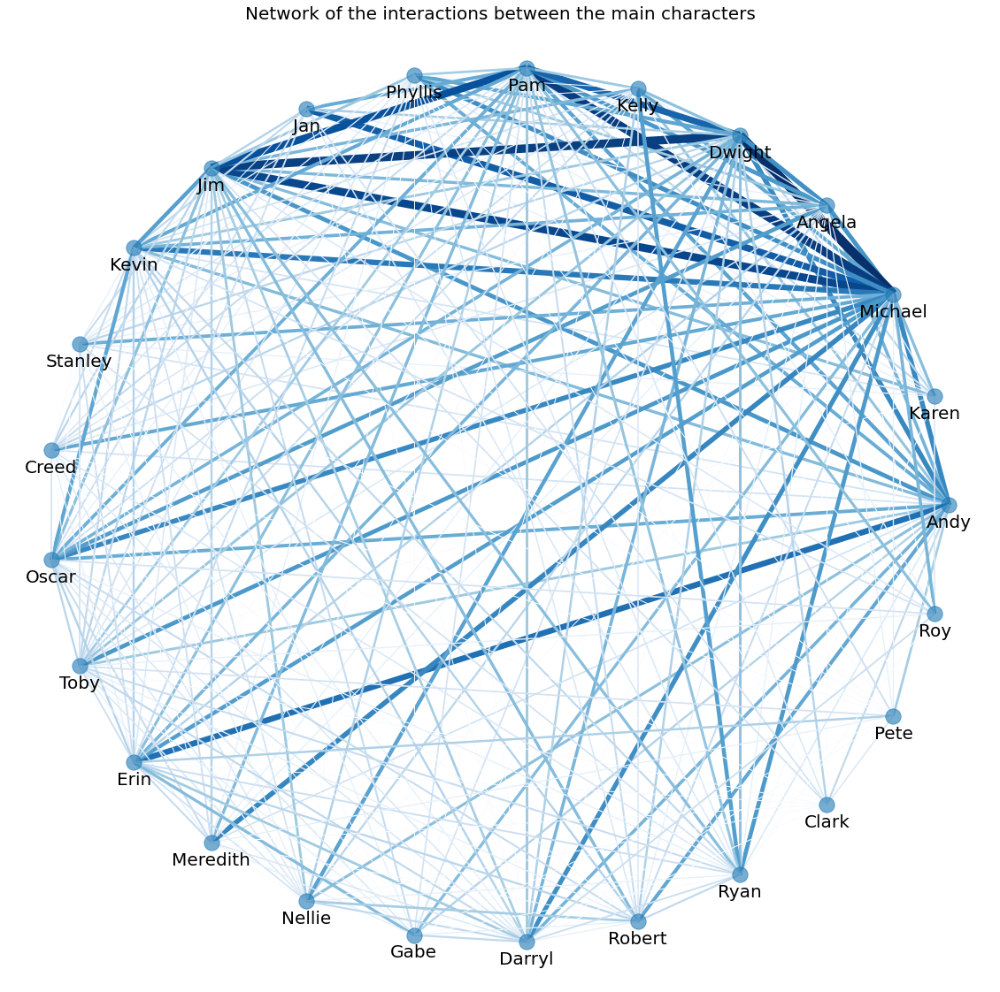

In [416]:
positions = nx.circular_layout(G_interactions)

fig = plt.figure(figsize=(20,20))

nx.draw_networkx_nodes(G_interactions,pos=positions, alpha=0.6)
nx.draw_networkx_edges(G_interactions,pos=positions, edge_color=colors, edge_cmap=plt.cm.Blues, width=weights)
labels_pos = {name: [pos_list[0], pos_list[1]-0.04] for name, pos_list in positions.items()}
nx.draw_networkx_labels(G_interactions, labels_pos, font_size=20)
    
plt.title(f"Network of the interactions between the main characters", fontsize=20)
plt.axis('off')
plt.savefig('plots/interactions_network.png')
plt.show()

The above network shows the interactions between the main characters of The Office. The edge weight represents the number of interations between the characters the edge connects, i.e, the stronger the blue edge is, the more interations there are between the characters.

From this network we can again see that Michael is the character that interacts with most characters, more specifically, Dwight, Pam, Jan and Jim. These, excluding Jan, are the characters that we previously identified as the ones with most lines during all the series. So there is clearly a relation between the top speakers and their relationships. The other characters interact between them in a normal manner. 

### Sentiment Analysis<a class="anchor" id="transcripts_sentiment_analysis"></a>

The goal is now to perform sentiment analysis of each character in the series based on their transcripts.

For the sentiment analysis, we will use both the LabMT and Vader method, for comparison. 


#### LabMT method


We first downloaded the LabMT wordlist. Then the LabMT wordlist was converted into a pandas dataframe `LabMT`, containing the file contents. This will be used later in the analysis.

To create the dataframe, we use the `read_csv` function from the pandas library, specify the file name, the row separator `\t`, the index of the header `0`, and the number of rows that need to be skipped until we get to the actual content: `3`. Some of the column values are set to `--`, we replace those with `NaN`, for easy usage in the analysis.

In [302]:
# parse file
LabMT = pd.read_csv('data/LabMT_Data_Set_S1.txt', sep="\t", header=0, skiprows=3)
LabMT = LabMT.replace('--', np.NaN) # replace -- with Nan
LabMT.head()

,word,happiness_rank,happiness_average,happiness_standard_deviation,twitter_rank,google_rank,nyt_rank,lyrics_rank
0,laughter,1,8.50,0.9313,3600,NaN,NaN,1728
1,happiness,2,8.44,0.9723,1853,2458,NaN,1230
2,love,3,8.42,1.1082,25,317,328,23
3,happy,4,8.30,0.9949,65,1372,1313,375
4,laughed,5,8.26,1.1572,3334,3542,NaN,2332


From the `LabMT` data, when calculating the sentiments, we are interested in getting the `happiness_average`. Hence, we create a function to get the `happiness_average` of a word. 

In [303]:
def get_happiness_average(word):
    """ Get the happiness average of a word from LabMT dataframe """
    if word in list(LabMT.word):
        return float(LabMT.loc[LabMT['word'] == word]['happiness_average'])
    return None

Next, we use the dialogs we dowloaded from Kaggle: `The-Office-Lines-V4.csv` and that we have previously extracted in a dataframe. This dataframe contains all the lines that were said in The Office during the 9 seasons, along with the character (speaker) for each line.

For the sentiment analysis of the character lines, we need to convert the lines into a list of tokens, using the same strategy as in the word-clourds, with the function `get_tokens`. For each character:

    1. Divide the dialog string into tokens using `WordPunctTokenizer.tokenize()`
    2. Remove non-alpha numeric tokens
    3. Convert the tokens to lower case, excludingh stop-words.
    4. Lemantize the token using `WordNetLemmantizer`

Once the tokens have been calculated, and the LabMT data has been preprocessed, the sentiments can be calculated for each token.  

To calculate the sentiment of a list of tokens, we created the `get_token_sentiment` function. This function does the following: 

   1. Calculates the frequency (number of occurences) of each token in the list of tokens of a dialog. 
    
   2. For each token in the list of tokens, calculate the sentiment score, `sentiment`. The sentiment score of a token is given by the frequency of that token in the token list `freq_dist[token]` multipled by the hapiness average of the token. 
    The hapiness average is obtained from the LabMT dataframe `happiness_average` column. We encountered that not all tokens are present in the LabMT dataframe. When this is the case, the token is just ignored.
    
   3. The average sentiment of the token list is then calculated. 

In [417]:
def get_token_sentiment(tokens):
    freq_dist = dict(nltk.FreqDist(tokens)) # calculate frequency of tokens
    
    sentiment = 0
    total_freq = 0 # keept track of the total frequency for all tokens
    # we do not use all tokens as some of them are not present in the LabMT dataset, and those are ignored. Hence we cannot just use the sum over the freq_dist
    
    for token in tokens:
        hapiness_avg = get_happiness_average(token)
        if not hapiness_avg: continue # ignore token if not present in LabMT

        sentiment += freq_dist[token] * hapiness_avg
        total_freq += freq_dist[token]
        
    avg_sentiment = sentiment/total_freq
    
    return avg_sentiment

The sentiments for the character lines (parsed into a list of tokens) are then calculated using the above described `get_token_sentiment` function.  sentiments are stored in a dictionary, where the key is the character and the value is the sentiment score of the characters dialog.

In [420]:
sentiments = {}
for character, tokens in characters_tokens.items():
    sentiment = get_token_sentiment(tokens) 
    sentiments[character] = sentiment

To analysis the character's associated sentuments, we create a histoigram.

In [421]:
fig = go.Figure(
    data=[go.Histogram(x=list(sentiments.values()))],
    layout=go.Layout(
        title=go.layout.Title(text="Histogram of all characters associated transcripts-sentiments using the LabMT method"),
        xaxis_title="sentiment score",
        yaxis_title="count"
    )
)

fig.show()
fig.write_json("plots/sentiments/01-labMT_sentiments.json")

From the above histogram, we cannot see much variation on the character sentiments. We can further use the calculated sentiments to get the happiest and saddest characters based on their transcripts during the 9 seasons. We focus on the 10 happiest and saddest characters. 

To get the 10 happiest and saddest characters, we sort the sentiments dictionary by sentiment from high to low, and return the first and the last 10 characters, where the first 10 represent the happiest and the last 10 the saddest characters.

In [422]:
sorted_sentiments = {character: sentiment for character, sentiment in sorted(sentiments.items(), key=lambda item: item[1], reverse=True)}

In [423]:
fig = go.Figure(
    data=[go.Scatter(x=list(sorted_sentiments.keys()), 
                 y=list(sorted_sentiments.values()),
                 text=list(sorted_sentiments.values()), texttemplate = "%{text:.3s}", 
                 textposition="bottom center")],
    
    layout=go.Layout(
        title=go.layout.Title(text="Characters based on sentiment score"),
        xaxis_title="character",
        yaxis_title="sentiment score"
    )
)
fig.update_traces(hoverinfo='text', mode='lines+markers+text' )

fig.update_traces(marker=dict(size=12,
                              color='Orange',
                              line=dict(width=2,
                                        color='DarkSlateGrey')))

fig.show()
fig.write_json("plots/communities/02-LabMT-characters.json")

Now we can look more in depth into the character transcripts by looking at the polarity of the different dialogs. For this, we use the VADER method. We apply the `sentimentIntensityAnalyzer().polarity_scores` method the from `vaderSentiment` library to the characters dialogs dictionary. For this we first create a `SentimentIntensityAnalyzer`.

In [424]:
analyzer  = SentimentIntensityAnalyzer()

Unlike when we used the LabMT method, now with the VADER data, we are going to keep punctuation and ALL-CAPS words. Hence, we keep the data as in the original dataframe `transcripts_df_grouped`, without any modifications. Then for each character dialog, we calculate the polarity of each sentence in the dialog using the `polarity_scores` function. Then we calculate the average polarity scores for each character.

In [425]:
character_polarity = {}
for character, transcript in transcripts_df_grouped.items():
    transcript_polarity = []
    for line in transcript: 
        line_polarity = analyzer.polarity_scores(line)['compound']
        transcript_polarity.append(line_polarity)
        
    character_polarity[character] = np.mean(transcript_polarity)

As we did with the LabMT method, we now create a histogram for the character polarities. It is important to note that 
- a polarity score represents a positive sentiment when is $>=0.05$
- a polarity score represents a neutral sentiment when $0.05 < polarity > -0.05$
- a polarity score represents a negative sentiment when is $<= -0.05$

In [426]:
fig = go.Figure(
    data=[go.Histogram(x=list(character_polarity.values()))],
    layout=go.Layout(
        title=go.layout.Title(text="Histogram of all characters associated dialogue-sentiments using the Vader method"),
        xaxis_title="polarity score",
        yaxis_title="count"
    )
)

fig.show()
fig.write_json("plots/sentiments/03-vader_sentiments.json")

From the above plot we can see that all the characters are either neutral or positive, but not negative. We can now classify the sentiments based on the polarity to see a more clear distribution.

In [427]:
def polarity_to_text(x):
    if x >= 0.05:
        return 'positive'
    elif x <= -0.05:
        return 'negative'
    else:
        return 'neutral'
    
polarities = list(map(lambda x: polarity_to_text(x),character_polarity.values()))
polarities_count = {'negative': polarities.count('negative'),
                    'positive': polarities.count('positive'),
                    'neutral': polarities.count('neutral')
                   }

In [428]:
fig = go.Figure(
    data=[go.Scatter(x=list(polarities_count.keys()), 
                 y=list(polarities_count.values()),
                 text=list(polarities_count.values()))],
    layout=go.Layout(
        title=go.layout.Title(text="Vader polarity distribution"),
        xaxis_title="polarity",
        yaxis_title="count"
    )
)

fig.show()
fig.write_json("plots/sentiments/04-sentiment_distribution_vader.json")

As we saw in the first VADER histogram, there are no negative sentiments. The majority of sentiments are positive, and only a few are neutral. Let's now look at who are the happiest and the saddest character based on the Vader method:

In [429]:
sorted_polarities = {character: polarity for character, polarity in sorted(character_polarity.items(), key=lambda item: item[1], reverse=True)}

In [430]:
fig = go.Figure(
    data=[go.Scatter(x=list(sorted_polarities.keys()), 
                 y=list(sorted_polarities.values()),
                 text=list(sorted_polarities.values()), texttemplate = "%{text:.3f}", 
                 textposition="bottom center")],
    
    layout=go.Layout(
        title=go.layout.Title(text="Characters based on polarity score"),
        xaxis_title="character",
        yaxis_title="polarity score"
    )
)
fig.update_traces(hoverinfo='text', mode='lines+markers+text' )

fig.update_traces(marker=dict(size=12,
                              color='Orange',
                              line=dict(width=2,
                                        color='DarkSlateGrey')))

fig.show()
fig.write_json("plots/sentiments/05-Vader-characters.json")

We can see that Clark Green is the most positive character in the office. However, he was only present in season 9. Michael, present in 7 seasons, is the most positive character after Clark. This makes sense as he is the regional manager as his job is to be friends with everyone and motivate them. Among the most positives we can also find Jim and Pam who are always friendly to everyone. Besides, Pam is the receptionist for the first 4 seasons, which implies that she needs to have a positive approach towards others in the office and those calling.

Starting from Dwight, the characters start being more neutral than positive. Specially the fact that Angela, Meredith and Stanley are the least positive. These three characters are always mean to everyone and generally unhappy in comparison to the rest. They always criticize other's actions, and never show positive reactions. 

As we did before, we will look into the characters sentiment development through the seasons. 

In [431]:
fig = make_subplots(rows=3, cols=3,vertical_spacing = 0.07,
                    x_title='character',
                    y_title='polarity score',
                    subplot_titles=('Season 1', 'Season 2', 'Season 3', 'Season 4', 'Season 5', \
                                                   'Season 6', 'Season 7', 'Season 8', 'Season 9'))

for i, season in enumerate(main_character_transcripts_df['season'].unique()):# loop through the keys of the wordcloud_strings dictionary (every race) 
    transcripts_df_season = main_character_transcripts_df. \
            loc[main_character_transcripts_df['season'] == season] \
            .groupby(by='speaker')['line'].apply(list).to_dict()
    
    character_polarity = {}
    for character, transcript in transcripts_df_season.items():
        transcript_polarity = []
        for line in transcript: 
            line_polarity = analyzer.polarity_scores(line)['compound']
            transcript_polarity.append(line_polarity)
        
        character_polarity[character] = np.mean(transcript_polarity)
    
    sorted_polarities = {character: polarity for character, polarity in sorted(character_polarity.items(), key=lambda item: item[1], reverse=True)}    

    
    trace = go.Scatter(x=list(sorted_polarities.keys()), y=list(sorted_polarities.values()), fill='tozeroy')
    fig.add_trace(trace, row = (i//3)+1 , col = (i%3)+1)
    
fig.update_layout(height=1500, width=1200, showlegend=False, title_text="Character polarity distribution throught seasons")
fig.show()
fig.write_json("plots/sentiments/06-characters_polarities_seasons.json")

We can see that the character sentiments vary from season to season. It is also interesting to see that some seasons are more positive than others. For example, the first and fourth seasons are the only ones that include negative tokens. We will later on analyse if there is a relation between the writer of the episodes and the sentiments. 

### Word-clouds from the Transcripts Dataset <a class="anchor" id="transcripts_wordclouds"></a>

Now we will create word-clouds for the 16 main characters based on the lines spoken thought the 9 seasons, and we will compare these to the previously generated wordclouds based on the descriptions from Dunderpedia.

In [432]:
main_characters = ['Andy', 'Angela', 'Creed', 'Darryl', 'Dwight', \
                  'Jim', 'Kelly', 'Kevin', 'Meredith', 'Michael', 'Pam', \
                  'Phyllis', 'Ryan', 'Stanley', 'Oscar', 'Toby']
main_characters_tokens = dict(filter(lambda elem: elem[0] in main_characters, characters_tokens.items()))

In [433]:
tc_idf_by_character = {}
len_documents = len(list(main_characters_tokens.values()))
for character_name, tokens in main_characters_tokens.items(): 

    document_df = calculate_df(tokens)
    tc_idf_by_character[character_name] = calculate_tc_idf(tokens, document_df, len_documents)

In [434]:
wordcloud_strings = {}
for name, tokens in tc_idf_by_character.items():
    wordcloud_strings[name] = ""

    for word, frequency in tokens.items():
        frequency = round(frequency)
        wordcloud_strings[name] += f"{word} " * frequency

Next we construct the word clouds for each character

<Figure size 25200x20160 with 0 Axes>

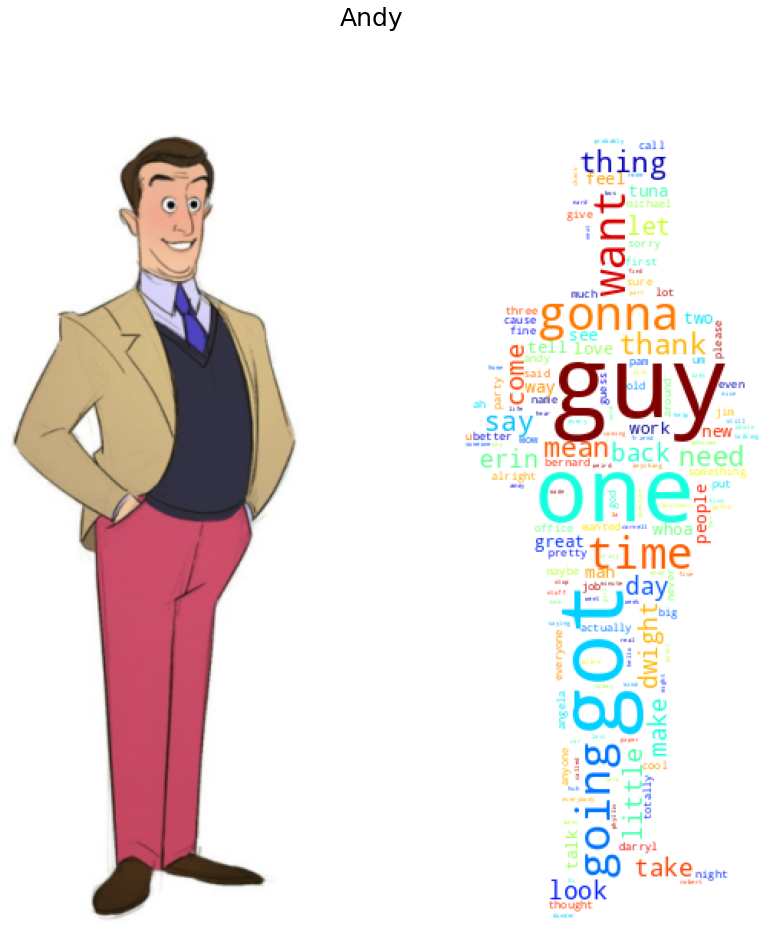

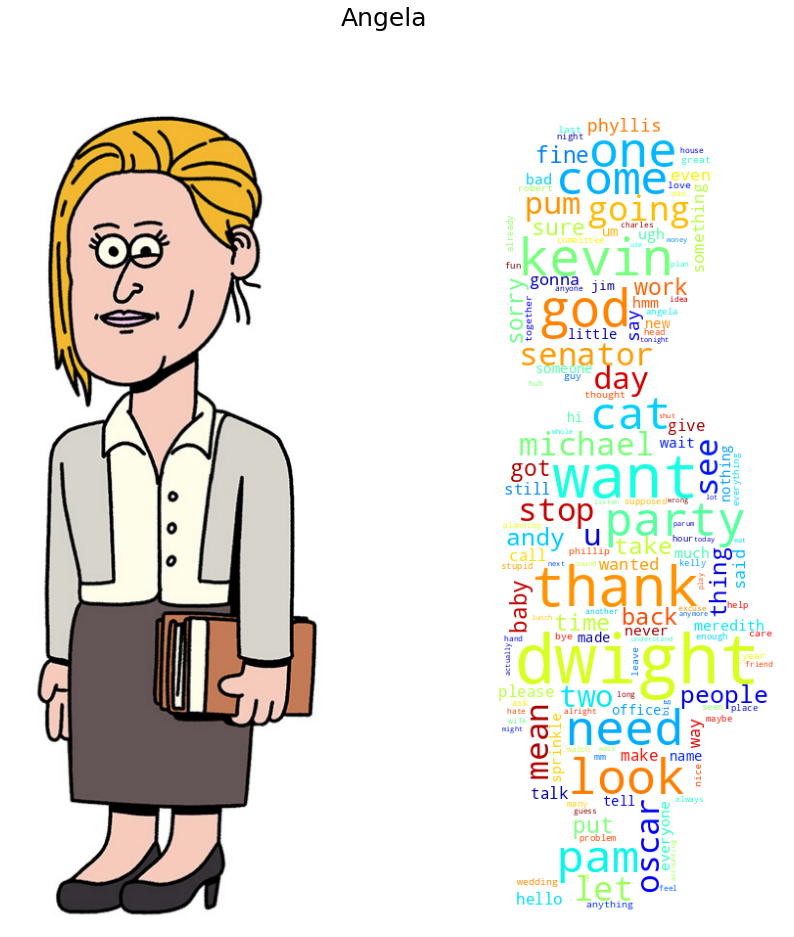

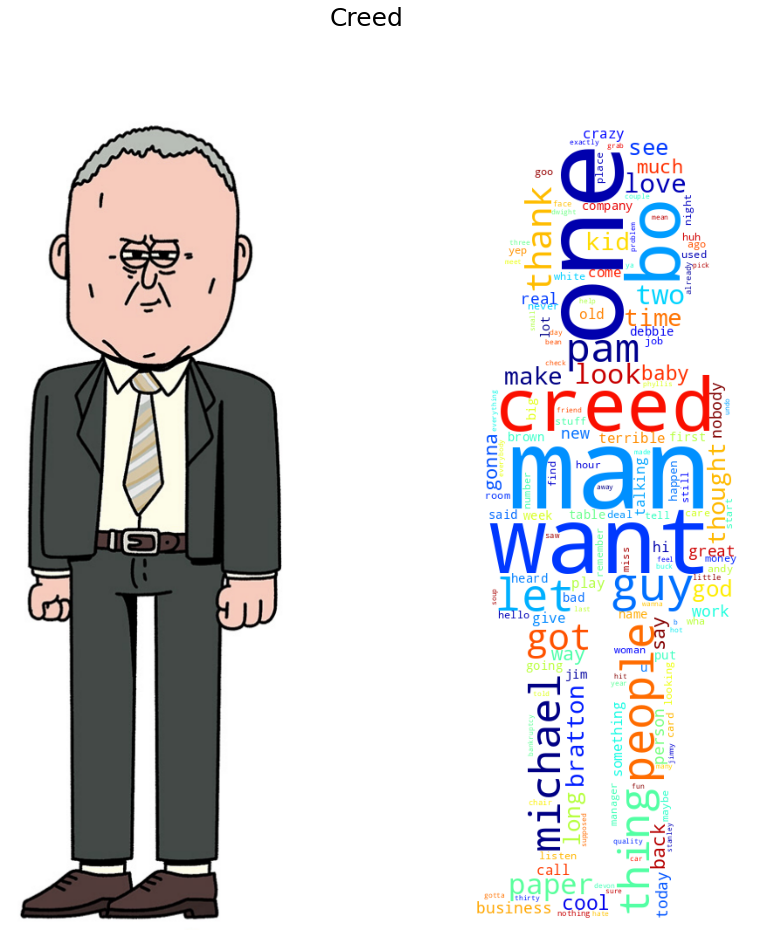

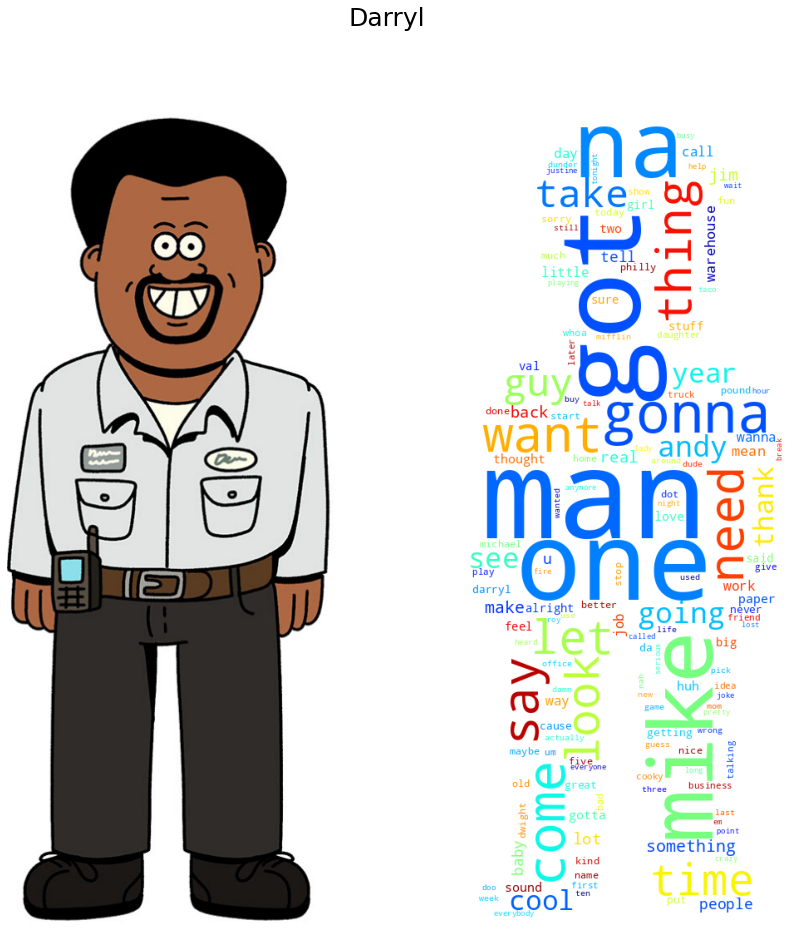

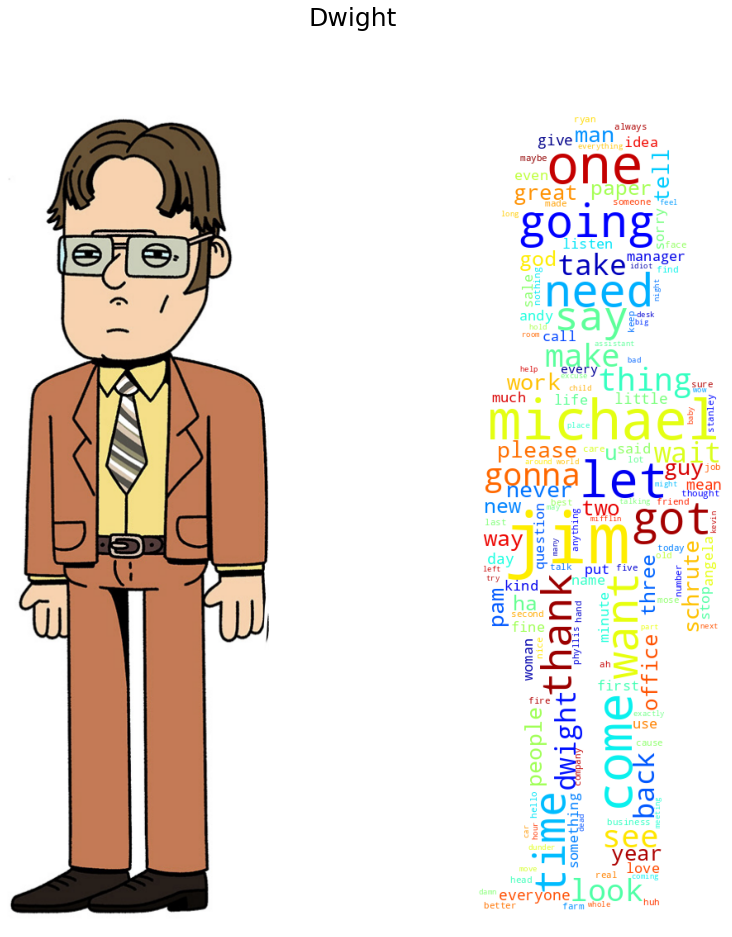

...

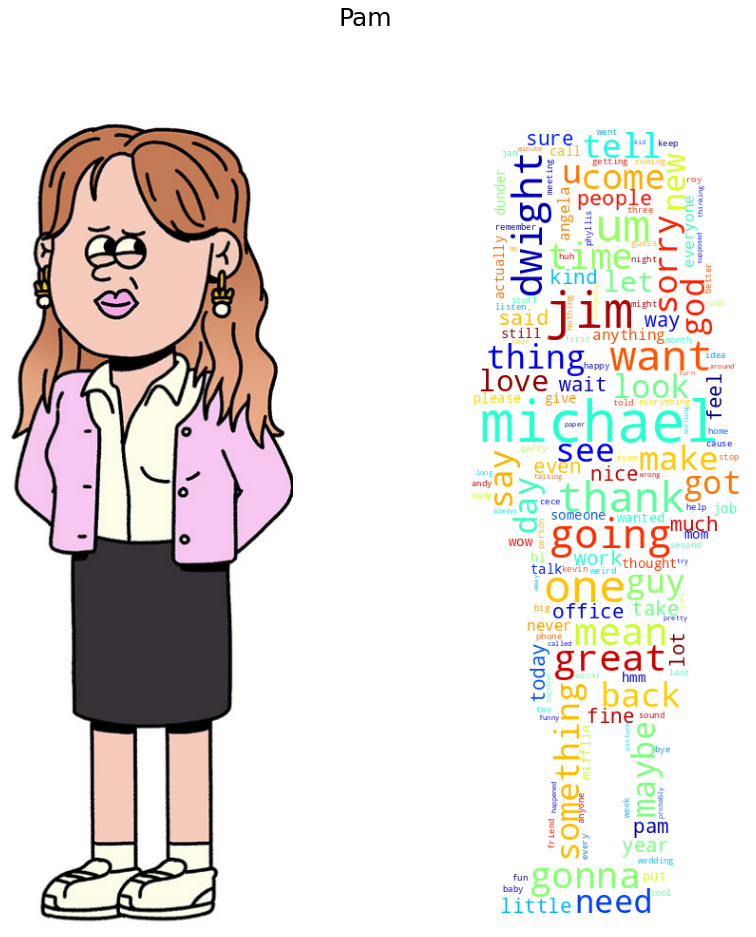

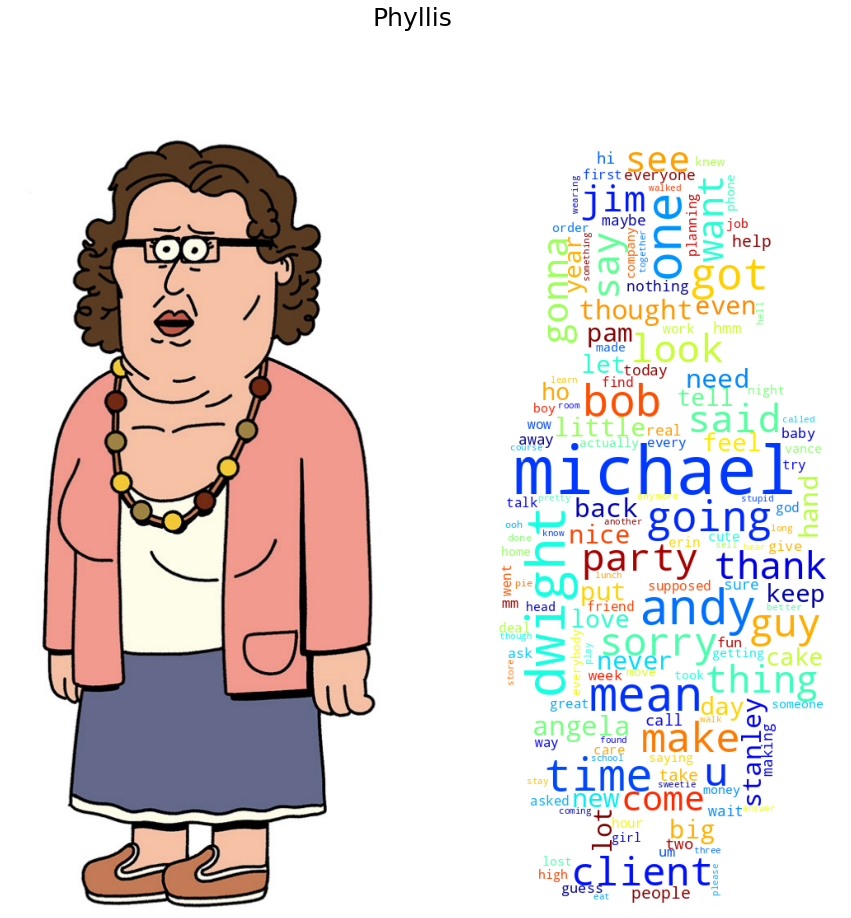

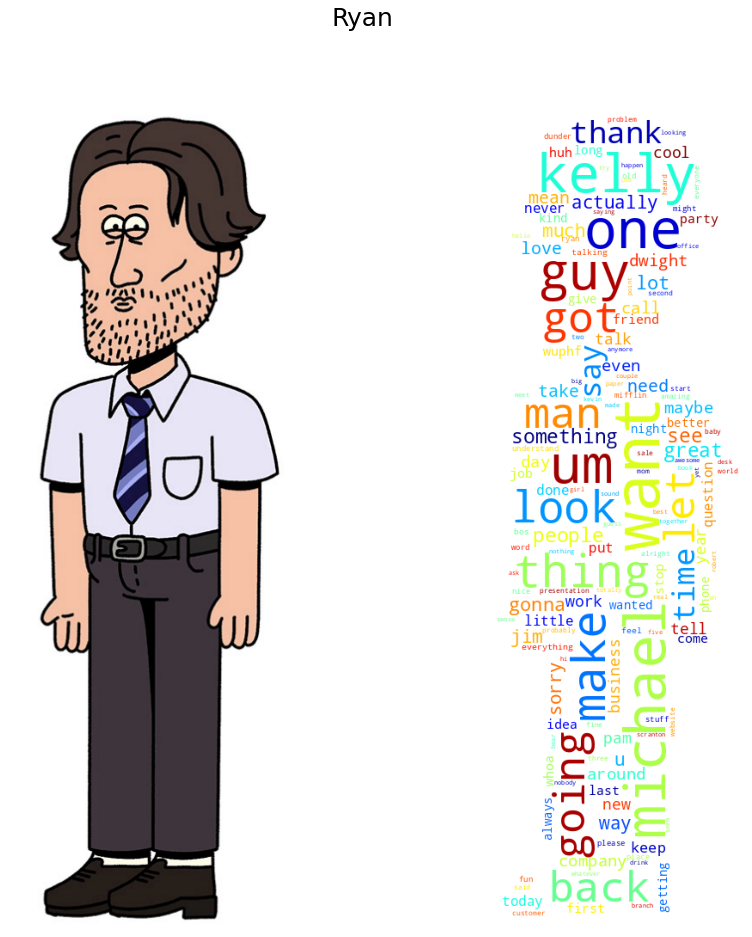

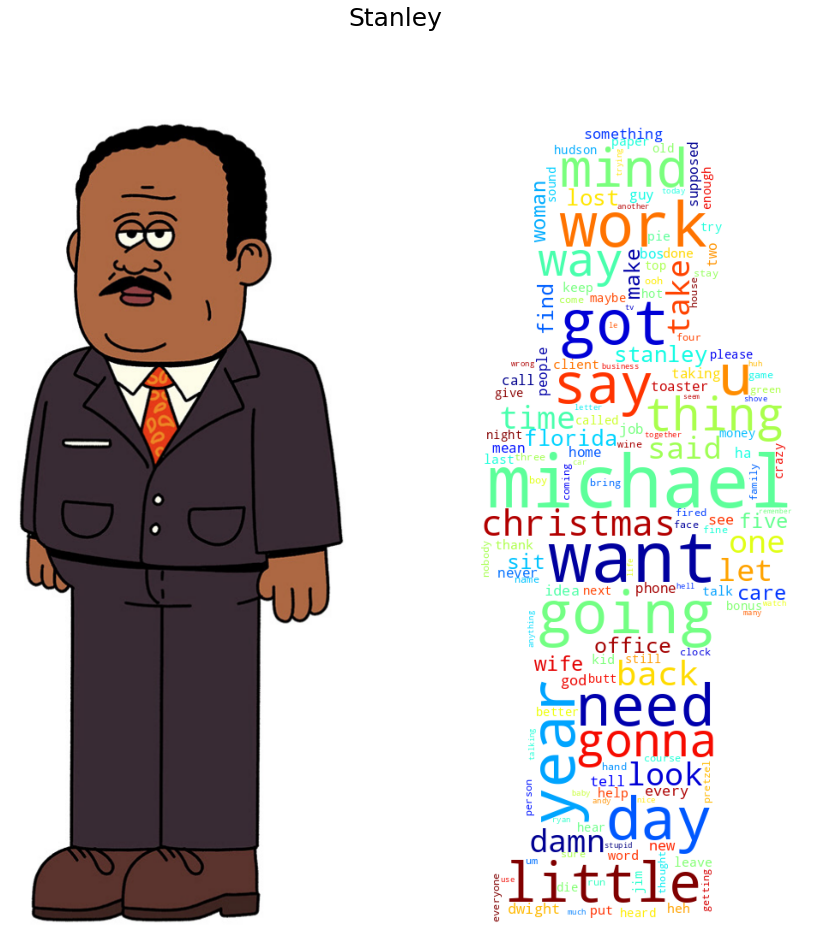

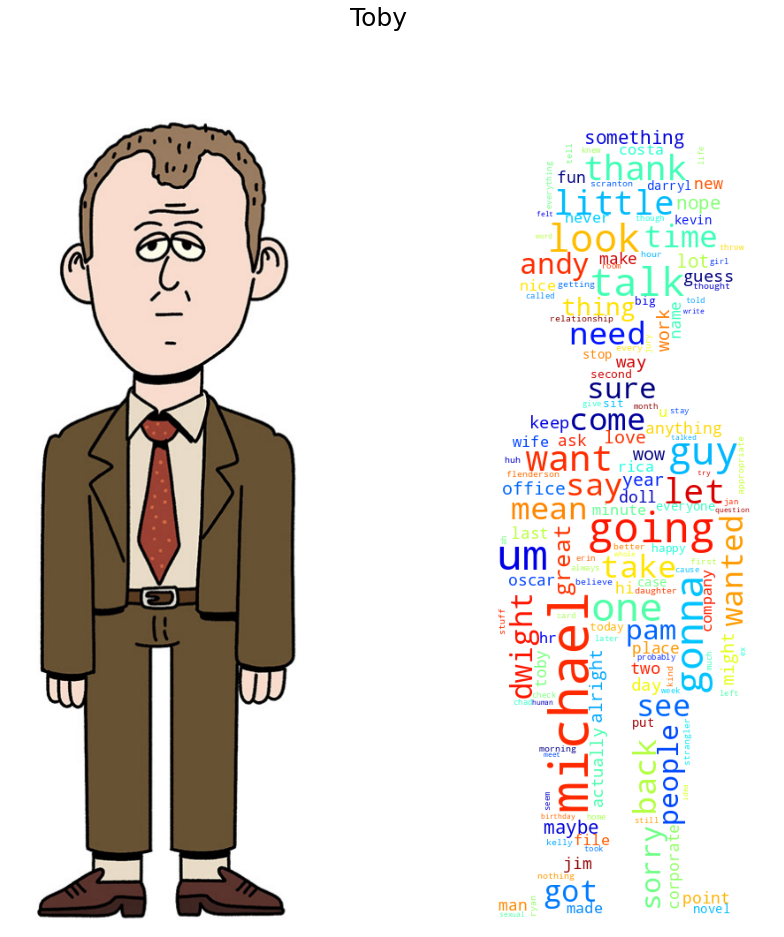

In [435]:
fig = plt.figure(figsize=(350, 280))

for name in wordcloud_strings.keys():
    plot_wordcloud(name, 'transcripts')

Looking at the word-clouds generated from the transcripts, it can be seen that in some cases they do not tell much about the characters themselves, in comparison to the word-clouds obtained from the charaters's descriptions. 

For example, thanks to the word-cloud from Dwight's description, we could see that he was German, he was proud of his surname, and he lives in a farm. 

From these new word-clouds, use the word Michael a lot. Then they use conversational nouns such as look, let, talk. This makes sense, since they are constantly having converstations between each other.

### Word-clouds from the Transcripts Dataset for all seasons <a class="anchor" id="transcripts_wordclouds_seasons"></a>

Lastly, we look into the season data and we create wordclouds from the transcripts. 

In [436]:
transcripts_df_grouped = transcripts_df.groupby(by='season')['line'].apply(list).to_dict()

all_characters_tokens = {}
for character, lines in transcripts_df_grouped.items():
    tokens = get_tokens(lines)
    all_characters_tokens[character] = tokens

In [437]:
tc_idf_by_character = {}
len_documents = len(list(all_characters_tokens.values()))
for season, tokens in all_characters_tokens.items(): 

    document_df = calculate_df(tokens)
    tc_idf_by_character[season] = calculate_tc_idf(tokens, document_df, len_documents)

In [438]:
wordcloud_strings = {}
for season, tokens in tc_idf_by_character.items():
    wordcloud_strings[season] = ""

    for word, frequency in tokens.items():
        frequency = round(frequency)
        wordcloud_strings[season] += f"{word} " * frequency

In [439]:
def plot_wordcloud_season(season):
    vals = np.linspace(0,1,256) # initialize a matrix of color values
    np.random.shuffle(vals)     # randomize them    

    fig = plt.figure(figsize=(15,15))

    wordcloud = WordCloud(
        width = 1600, height= 800,
        max_words= 150,
        background_color='white',
        collocations=False,
        colormap= plt.cm.colors.ListedColormap(plt.cm.jet(vals)) # use the randomized colormap
    ).generate(wordcloud_strings[season]) 
    
    plt.imshow(wordcloud)
    plt.axis('off')    
   
    plt.title(f"Season: {season}", fontsize=25)
    plt.savefig(f'plots/wordclouds/seasons/season_{season}.png')
    plt.show()

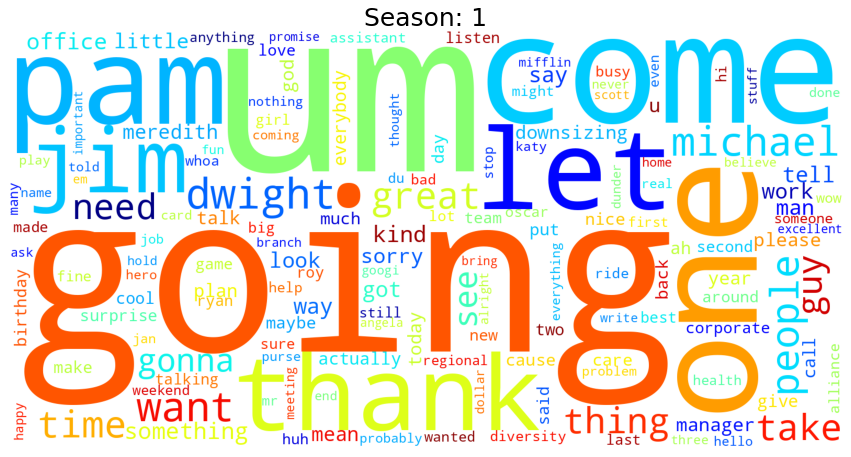

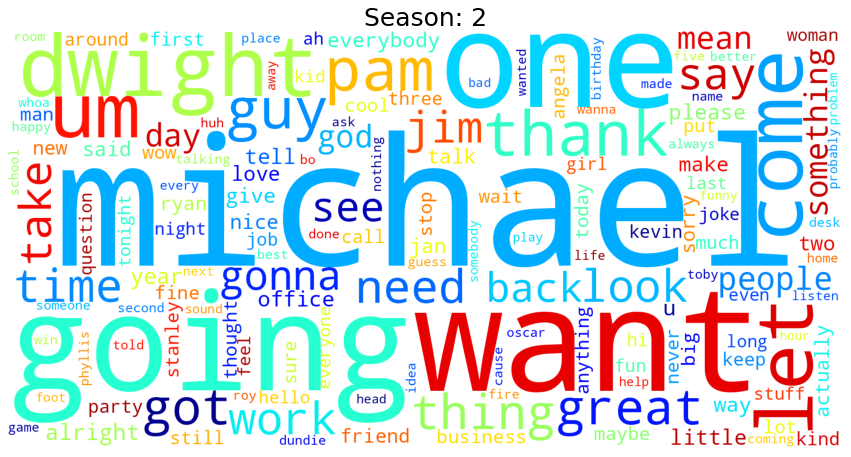

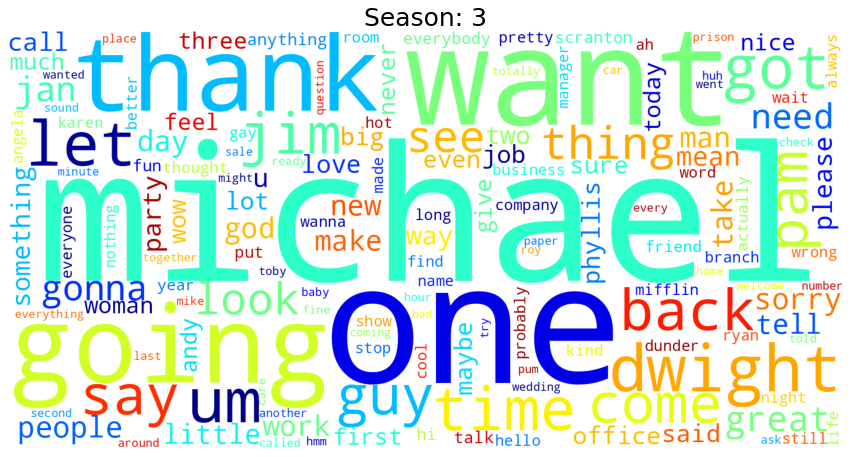

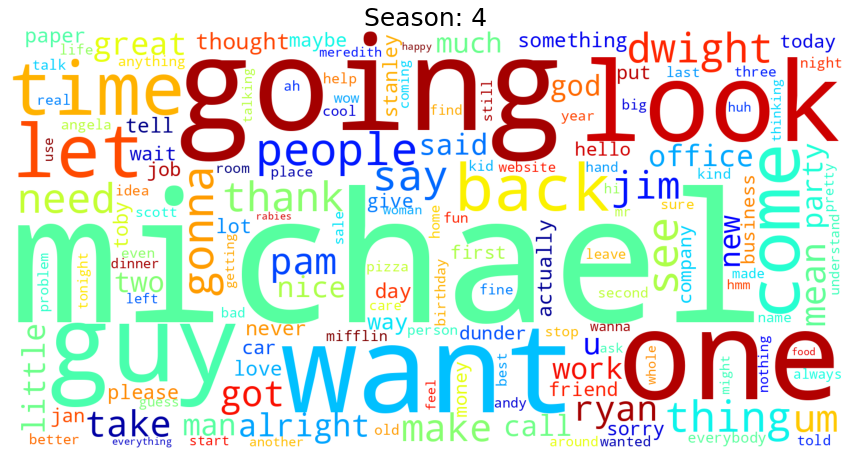

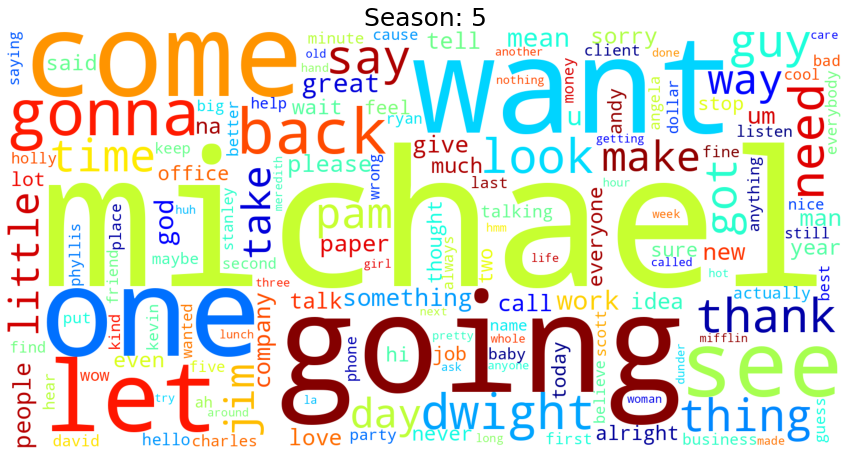

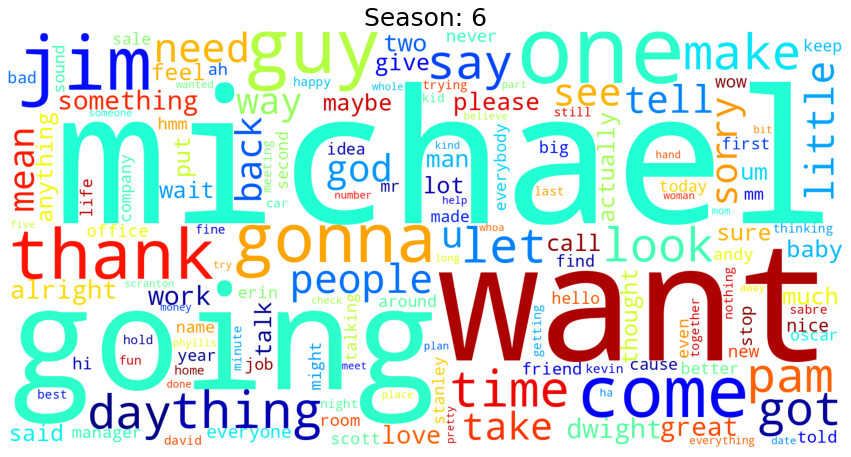

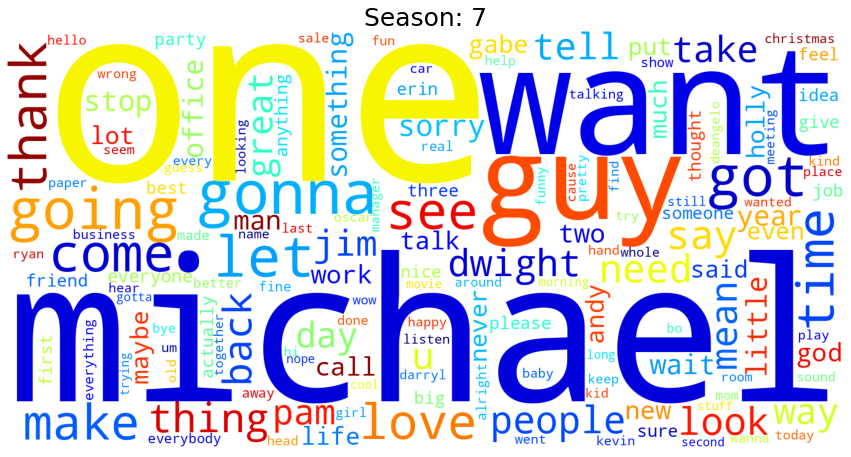

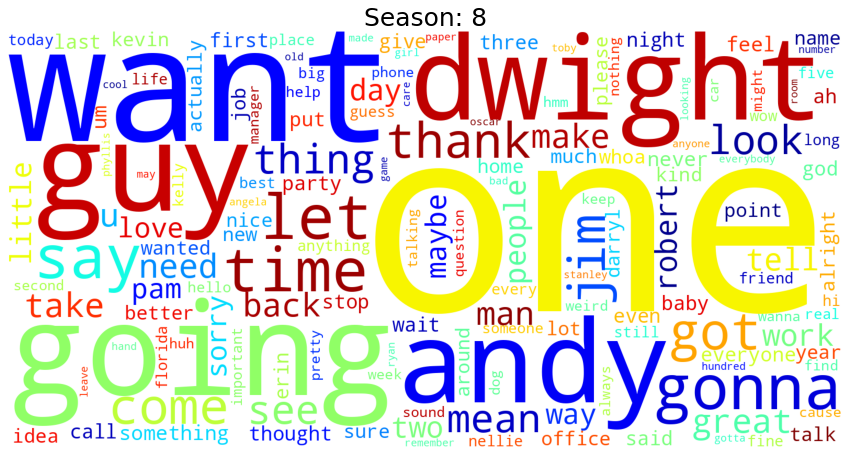

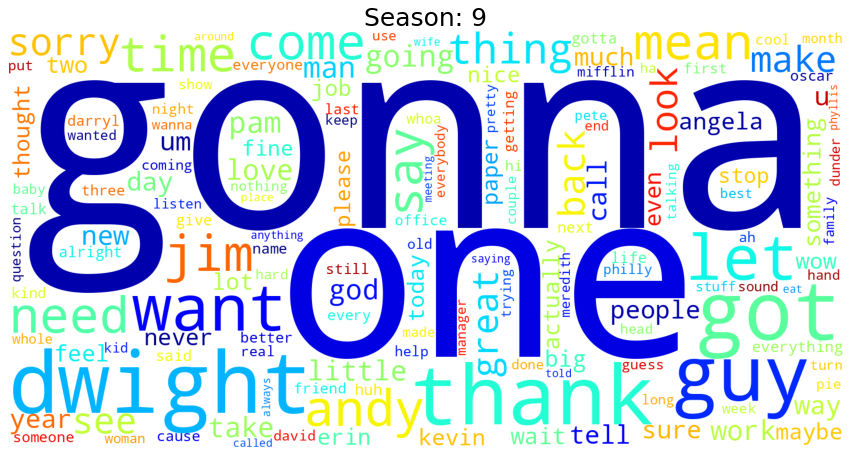

In [440]:
for season, num in zip(list(wordcloud_strings.keys()), range(1, 10)):
    plot_wordcloud_season(season)

# Discussion

# Contributions